# <center> Modelos Predictivos COVID-19 Región de Murcia

Imports necesarios para la correcta ejecución del Notebook.

In [1]:
# Trabajo con dataframes
import pandas as pd
# Lectura de datos
from pandas import read_csv
# Mapa de calor
import seaborn as sn
# Plots, visualización de gráficas
import matplotlib.pyplot as plt
# Arrays
import numpy as np
# Lectura de directorio
import os
# Normalización de los datos
from sklearn.preprocessing import MinMaxScaler
# Gráficos
import plotly.express as px
import plotly

# Importación y análisis exploratorio

Lectura del conjunto de datos obtenido de la pagina de salud de Murcia 
https://www.murciasalud.es/pagina.php?id=458869
Recogidos desde el 08/03/2020 hasta el dia 25/03/2020.

In [2]:
lectura = read_csv('../Datos_originales/casos_diarios_total_regional.csv', skiprows = 4, encoding='latin-1', sep = ';', na_values = ['NaN', 'NaT'])

# Headers = columnas de mi conjunto de datos. Si no especificamos asume que son las de la primera fila leida
# Skiprows = n: con n = numero de filas que quiero saltar. Las cuatro primeras son texto -> las saltamos
# Encoding = 'latin-1': para que no de errores de codificacion de algunos caracteres 
# Sep = ';': delimitador que separa las columnas
# Index_col = 0: usar la primera columna (fechas) como filas del dataframe

Renombramos los nombres de algunas de las columnas para que queden mas compactos.

In [3]:
datos = lectura.rename(columns={'Pruebas_PCR_Ag':'Pruebas',
                                'Casos_incidentes_PCR/Ag+':'Incidentes',
                                'Hospitalizados': 'H',
                                'Hospitaliz_UCI':'H_UCI',
                                'Asintomatico_hombre_<45años': 'Asint_H_<45',
                                'Asintomatico_hombre_45a64años': 'Asint_H_45a64',
                                'Asintomatico_hombre_+65años': 'Asint_H_+65',
                                'Sintomatico_hombre_<45años': 'Sint_H_<45',
                                'Sintomatico_hombre_45a64años': 'Sint_H_45a64',
                                'Sintomatico_hombre_+65años': 'Sint_H_+65',
                                'Asintomatico_mujer_<45años': 'Asint_M_<45',
                                'Asintomatico_mujer_45a64años': 'Asint_M_45a64',
                                'Asintomatico_mujer_+65años': 'Asint_M_+65',
                                'Sintomatico_mujer_<45años': 'Sint_M_<45',
                                'Sintomatico_mujer_45a64años': 'Sint_M_45a64',
                                'Sintomatico_mujer_+65años': 'Sint_M_+65'})

Convertimos los datos leidos en un dataFrame y lo mostramos para ver su apariencia.

In [4]:
df_salud_murcia = pd.DataFrame(datos)
df_salud_murcia.head(3)

,Fecha,Pruebas,Incidentes,H,H_UCI,Defunciones,Asint_H_<45,Asint_H_45a64,Asint_H_+65,Sint_H_<45,Sint_H_45a64,Sint_H_+65,Asint_M_<45,Asint_M_45a64,Asint_M_+65,Sint_M_<45,Sint_M_45a64,Sint_M_+65
0,08/03/2020,130.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1,09/03/2020,21.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0
2,10/03/2020,39.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,2.0,0.0,0.0


Lo siguiente que haremos es indexar el dataframe por la columna 'Fecha'. Para ello, primero debemos convertir la misma en un objeto de tipo DatatimeIndex. Usamos la funcion 'to_datetime' y le indicamos el formato en el que se encuentran las fechas para que se lea y procese bien. Posteriormente eliminamos la columna del dataFrame e insertamos el nuevo DatatimeIndex como íncide. Finalmente mostramos el resultado.

In [5]:
format = '%d/%m/%Y'
datetime_fecha = pd.to_datetime(df_salud_murcia['Fecha'], format = format)
df_salud_murcia = df_salud_murcia.drop(['Fecha'], axis=1)
df_salud_murcia.insert(0,'Fecha', datetime_fecha)
df_salud_murcia = df_salud_murcia.set_index('Fecha')
df_salud_murcia.head(3)

,Pruebas,Incidentes,H,H_UCI,Defunciones,Asint_H_<45,Asint_H_45a64,Asint_H_+65,Sint_H_<45,Sint_H_45a64,Sint_H_+65,Asint_M_<45,Asint_M_45a64,Asint_M_+65,Sint_M_<45,Sint_M_45a64,Sint_M_+65
Fecha,,,,,,,,,,,,,,,,,
2020-03-08,130.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
2020-03-09,21.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0
2020-03-10,39.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,2.0,0.0,0.0


Con la siguiente función eliminamos todos aquellos valores que se almacenan o completan como NaN. 

In [6]:
df_salud_murcia.dropna(axis = 0, inplace = True)

## Sumando sintomáticos y asintomáticos

Sumamos asintomáticos y sintomáticos que estaban repartidos en tres grupos de edades. Eliminamos los grupos y nos quedamos con el total de cada uno en dos nuevas columnas del dataframe.

In [7]:
df_salud_murcia['Asintomaticos'] = df_salud_murcia['Asint_H_<45'] + df_salud_murcia['Asint_H_45a64'] + df_salud_murcia['Asint_H_+65'] + df_salud_murcia['Asint_M_<45'] + df_salud_murcia['Asint_M_45a64'] + df_salud_murcia['Asint_M_+65']
df_salud_murcia['Sintomaticos'] = df_salud_murcia['Sint_H_<45'] + df_salud_murcia['Sint_H_45a64'] + df_salud_murcia['Sint_H_+65'] + df_salud_murcia['Sint_M_<45'] + df_salud_murcia['Sint_M_45a64'] + df_salud_murcia['Sint_M_+65']

In [8]:
df_salud_murcia = df_salud_murcia.drop(['Asint_H_<45', 'Asint_H_45a64', 'Asint_H_+65', 'Asint_M_<45', 'Asint_M_45a64', 'Asint_M_+65', 'Sint_H_<45', 'Sint_H_45a64', 'Sint_H_+65', 'Sint_M_<45', 'Sint_M_45a64', 'Sint_M_+65'], axis=1)

A continuación lo que hacemos es guardarla en un archivo de extensión .csv para poder recuperarla posteriormente.

In [9]:
df_salud_murcia.to_csv(path_or_buf = '../Datos_preprocesados/salud_murcia.csv')

In [2]:
df_salud_murcia = read_csv('../Datos_preprocesados/salud_murcia.csv', encoding='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
df_salud_murcia = df_salud_murcia.set_index('Fecha')

In [3]:
copia = df_salud_murcia.drop(['Pruebas'], axis = 1)
fig = px.box(df_salud_murcia, y = copia.columns)
fig.show("notebook")

## Añadiendo Movilidad

Necesitamos añadir los datos de movilidad proporcionados por el Ministerio de Transporte y Movilidad en la Región de Murcia.
Para ello se buscaron los códigos de los municipios murcianos así como sus correspondientes códigos para el Ministerio, ya que no siempre coinciden. 

A continuación se definen las funciones necesarias para el correcto tratamiento de los datos.

La siguiente función permite parsear las fechas, a partir del nombre del fichero obtenemos la fecha correspondiente

In [11]:
def parseador_fechas_mitma(nombre):
    # Cogemos el día
    dia = nombre[6:8]
    # Cogemos el mes
    mes = nombre[4:6]
    # Cogemos el año
    anio = nombre[0:4]
    # Escribimos en formato año-dia-mes
    return(anio+'-'+dia+'-'+mes)

Al igual que hicimos con el dataframe de los datos de salud que leímos al principio, debemos transformar las fechas en objetos de tipo DatatimeIndex. Posteriormente las ordenaremos para que se muestren en orden cronológico. Para ello usamos la función 'to_datetime', que convierte nuestra lista de fechas en DatatimeIndex. Acto seguido creamos el dataframe con las entradas, las salidas a la Región de Murcia y las fechas y las ponemos como índice del dataframe. Ahora solo queda ordenarlo. Añadimos tres columnas adicionales al dataframe que son los meses, dias y años de las fechas. Ordenamos según estos valores y posteriormente las eliminamos del dataframe. Devolvemos el dataframe construido.

In [3]:
def conversor_a_dataframe(lista_fechas, lista_entradas, lista_salidas):
    format = '%Y-%d-%m'
    # Convertimos en DatatimeIndex
    fechas_serie = pd.to_datetime(lista_fechas, format = format)
    # Creamos dataframe con las entradas salidas y fechas
    df_entradas_salidas = pd.DataFrame(list(zip(lista_entradas, lista_salidas)), columns = ['Entradas', 'Salidas'], index = fechas_serie).rename_axis('Fecha', axis = 0)
    # Definimos las series para ordenar
    df_entradas_salidas['month'] = fechas_serie.month
    df_entradas_salidas['year'] = fechas_serie.year
    df_entradas_salidas['day'] = fechas_serie.day
    # Ordenamos por mes-dia-año
    df_entradas_salidas = df_entradas_salidas.sort_values(['year', 'month', 'day']).drop(columns=['day', 'month', 'year'])
    # Devolvemos el dataframe construido
    return df_entradas_salidas

La lista "codigos" contiene todos los códigos de los municipios de la Región con la codificación usada por el Ministerio.

In [4]:
# Los diferentes al resto
codigos = ['30901', '30902']

# Cogemos el resto de códigos de municipios
for i in range(1,44):
    if i < 10 and i not in [4,6]:
        codigos.append('3000'+str(i))
    if i >= 10 and i not in [14,27,29,31,32,34,39,40,42]:
        codigos.append('300'+str(i))
    if i == 4:
        codigos.append('30014_AM')
    if i == 6:
        codigos.append('30039_AM')
    if i == 14:
        codigos.append('30014_AM')
    if i == 27:
        codigos.append('3002701')
    if i == 29:
        codigos.append('30029_AM')
    if i == 31:
        codigos.append('30042_AM')
    if i == 32:
        codigos.append('30029_AM')
    if i == 34:
        codigos.append('30014_AM')
    if i == 39:
        codigos.append('30039_AM')
    if i == 40:
        codigos.append('30042_AM')
    if i == 42:
        codigos.append('30042_AM')

Lo siguiente que haremos es procesar todos los datos que tenemos. Para cada archivo, nos quedamos con las salidas y entradas en la Región de Murcia, esto es, no se considera la movilidad entre distintos municipios murcianos si no las salidas y entradas de municipios fuera de la Región hacia ella o desde municipios de la Región hasta municipios fuera de ella.

In [7]:
# Ruta hacia el directorio donde se encuentran los archivoss
ruta = '../Datos_originales/mitma_movilidad/'

# Lista para las fechas de recogida de datos
lista_fechas = []
# Lista para almacenar el total de entradas a la Región cada día
lista_entradas = []
# Lista para almacenar el total de salidas de la Región cada día
lista_salidas = []

# Cogemos los archivos .tar mensuales
archivos = os.listdir(ruta)

# Recorremos los archivos
for a in archivos:
    meses = os.listdir(ruta+a)
    # Cada archivo mensual válido lo procesamos
    for m in meses:
        # Repetición de archivos con ._ no válidos
        if "._" not in m:
            # Obtenemos la fecha
            fecha = parseador_fechas_mitma(m)
            lista_fechas.append(fecha)
            # Leemos el archivo correspondiente
            df = pd.read_csv(ruta+a+'/'+m, compression='gzip', sep='|', header=0, low_memory = False)
            # Nos quedamos solo con las salidas de la Región
            df_s = df[df['origen'].isin(codigos)]
            # Eliminamos los viajes en la propia Región
            df_s = df_s[~df_s['destino'].isin(codigos)]
            # Nos quedamos solo con las entradas a la Región
            df_e = df[df['destino'].isin(codigos)]
            # Eliminamos los viajes en la propia Región
            df_e = df_e[~df_e['origen'].isin(codigos)]
            # Sumamos todos los viajes que son las entradas y salidas
            salidas = df_s['viajes'].sum()
            entradas = df_e['viajes'].sum()
            # Añadimos a las listas
            lista_salidas.append(salidas)
            lista_entradas.append(entradas)

Convertimos los datos recogidos en un dataframe mediante la función definida anteriormente.

In [14]:
df_mitma = conversor_a_dataframe(lista_fechas, lista_entradas, lista_salidas)
df_mitma.tail(3)

,Entradas,Salidas
Fecha,,
2021-02-26,130495.728,126471.246
2021-02-27,73285.851,71385.928
2021-02-28,49817.997,49735.536


Vemos ahora el número de filas y el número de missing values.

In [15]:
df_mitma.shape

(374, 2)

In [16]:
df_mitma.isna().sum()

Entradas    0
Salidas     0
dtype: int64

Guardamos el conjunto de datos con la movilidad en un nuevo archivo con extensión csv.

In [17]:
df_mitma.to_csv(path_or_buf = '../Datos_preprocesados/movilidad.csv')

In [10]:
df_mitma = read_csv('../Datos_preprocesados/movilidad.csv', encoding='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
df_mitma = df_mitma.set_index('Fecha')

## Juntando los datos

En este apartado se juntan los dataframe de las dos fuentes de datos que se han procesado. De esta forma, a los datos de salud se le añaden los datos de movilidad generando un nuevo dataframe, que será con el que trabajaremos el resto del proyecto.

In [18]:
df_salud_movilidad = pd.concat([df_salud_murcia, df_mitma], axis=1)

Aparecen nuevos valores missing, debido a las diferentes fechas sobre las que se han recogido los datos.

In [19]:
df_salud_movilidad.head(3)

,Pruebas,Incidentes,H,H_UCI,Defunciones,Asintomaticos,Sintomaticos,Entradas,Salidas
Fecha,,,,,,,,,
2020-02-21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,166795.814,168567.936
2020-02-22,NaN,NaN,NaN,NaN,NaN,NaN,NaN,144424.897,144077.722
2020-02-23,NaN,NaN,NaN,NaN,NaN,NaN,NaN,138142.960,133974.435


Suprimimos los missing values.

In [20]:
df_salud_movilidad.dropna(axis = 0, inplace = True)

Guardamos en archivo de extensión csv el dataframe.

In [21]:
df_salud_movilidad.to_csv(path_or_buf = '../Datos_preprocesados/salud_movilidad.csv')

In [4]:
df_salud_movilidad = read_csv('../Datos_preprocesados/salud_movilidad.csv', encoding='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
df_salud_movilidad = df_salud_movilidad.set_index('Fecha')

Contamos de nuevo las filas y el número de missing values y los eliminamos.

In [26]:
df_salud_movilidad.shape

(358, 9)

In [27]:
df_salud_movilidad.isna().sum()

Pruebas          0
Incidentes       0
H                0
H_UCI            0
Defunciones      0
Asintomaticos    0
Sintomaticos     0
Entradas         0
Salidas          0
dtype: int64

## Visualización de series

In [5]:
for column in df_salud_movilidad:
    # Cogemos la serie correspondientes
    serie = df_salud_movilidad[column]
    # Dibujamos
    fig = px.line(serie, x = df_salud_movilidad.index, y = column, width = 700, height = 400)
    fig.show("notebook")

## Matriz de correlación

La matriz de correlación se presenta en forma de ''mapa de calor''. Los valores más violetas muestran una mayor correlación entre las correspondientes series de datos, mientras que los valores más claros (azules) muestran una menor correlación.

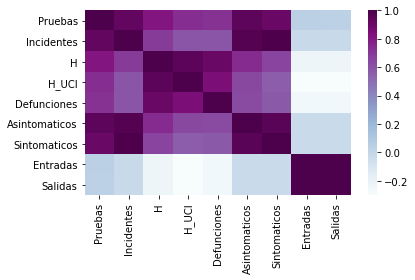

In [10]:
# Cremos la matriz de correlación
matriz_corr = df_salud_movilidad.corr()
# Generamos el mapa de calor a partir de la matriz
sn.heatmap(matriz_corr, annot = False, cmap = "BuPu")
# Para que no se corten los ejes
plt.tight_layout()
# Guardamos la imagen
plt.savefig('../../../imagenes/MatrizCorr.png')
plt.show()

## Transformaciones en los datos

Transformamos los datos que hemos recogido en secciones anteriores. En primer lugar creamos los dataframes con variables retrasadas (lag3 y lag5). Posteriormente realizamos una normalización de los datos.

### Creación de variables retrasadas

La siguiente función crea un predictor con el lag que se le pase como parámetro sobre el conjunto de datos.

In [17]:
def crear_predictor(lag):
    # Hacemos una copia del dataframe de datos
    df_predictor = df_salud_movilidad.copy()
    # Seleccionamos las columnas 
    columnas = df_predictor.columns
    # Recorremos las columnas
    for c in columnas:
        # Cogemos los valores de la serie correspondiente a la columna y el índice
        datos = pd.DataFrame(df_predictor[c].values, index = df_predictor.index)
        # Añadimos los lag mediante la función sift
        for i in range(1,lag+1):
            # Añadimos al predictor la nueva serie con el lag correspondiente en la última columna
            df_predictor.insert(len(df_predictor.columns), c+' t-'+str(i), datos.shift(i))
    # Queremos eliminar todas las columnas en t excepto la de incidentes, que es la que queremos predecir
    # Así que la eliminamos de la lista
    columnas = columnas.drop("Incidentes")
    # Eliminamos todas las columnas en t
    df_predictor = df_predictor.drop(columnas, axis=1)
    return df_predictor

Creamos dos predictores, uno con lag3 y otro con lag5

In [19]:
df_predictor_lag3 = crear_predictor(3)
df_predictor_lag3.dropna(axis = 0, inplace = True)
df_predictor_lag3.head(3)

,Incidentes,Pruebas t-1,Pruebas t-2,Pruebas t-3,Incidentes t-1,Incidentes t-2,Incidentes t-3,H t-1,H t-2,H t-3,...,Asintomaticos t-3,Sintomaticos t-1,Sintomaticos t-2,Sintomaticos t-3,Entradas t-1,Entradas t-2,Entradas t-3,Salidas t-1,Salidas t-2,Salidas t-3
Fecha,,,,,,,,,,,,,,,,,,,,,
2020-03-11,12.0,39.0,21.0,130.0,6.0,3.0,1.0,0.0,0.0,0.0,...,2.0,4.0,4.0,1.0,145999.438,146586.006,134872.118,145006.937,148231.629,129792.956
2020-03-12,9.0,116.0,39.0,21.0,12.0,6.0,3.0,0.0,0.0,0.0,...,0.0,10.0,4.0,4.0,145431.106,145999.438,146586.006,143921.173,145006.937,148231.629
2020-03-13,12.0,136.0,116.0,39.0,9.0,12.0,6.0,4.0,0.0,0.0,...,0.0,7.0,10.0,4.0,145470.771,145431.106,145999.438,144238.438,143921.173,145006.937


Guardamos.

In [52]:
df_predictor_lag3.to_csv(path_or_buf = '../Datos_preprocesados/predictor_lag3.csv')

In [20]:
df_predictor_lag3 = read_csv('../Datos_preprocesados/predictor_lag3.csv', encoding='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
df_predictor_lag3 = df_predictor_lag3.set_index('Fecha')
df_predictor_lag3.head(3)

,Incidentes,Pruebas t-1,Pruebas t-2,Pruebas t-3,Incidentes t-1,Incidentes t-2,Incidentes t-3,H t-1,H t-2,H t-3,...,Asintomaticos t-3,Sintomaticos t-1,Sintomaticos t-2,Sintomaticos t-3,Entradas t-1,Entradas t-2,Entradas t-3,Salidas t-1,Salidas t-2,Salidas t-3
Fecha,,,,,,,,,,,,,,,,,,,,,
2020-03-11,12.0,39.0,21.0,130.0,6.0,3.0,1.0,0.0,0.0,0.0,...,2.0,4.0,4.0,1.0,145999.438,146586.006,134872.118,145006.937,148231.629,129792.956
2020-03-12,9.0,116.0,39.0,21.0,12.0,6.0,3.0,0.0,0.0,0.0,...,0.0,10.0,4.0,4.0,145431.106,145999.438,146586.006,143921.173,145006.937,148231.629
2020-03-13,12.0,136.0,116.0,39.0,9.0,12.0,6.0,4.0,0.0,0.0,...,0.0,7.0,10.0,4.0,145470.771,145431.106,145999.438,144238.438,143921.173,145006.937


In [21]:
df_predictor_lag5 = crear_predictor(5)
df_predictor_lag5.dropna(axis = 0, inplace = True)
df_predictor_lag5.head(3)

,Incidentes,Pruebas t-1,Pruebas t-2,Pruebas t-3,Pruebas t-4,Pruebas t-5,Incidentes t-1,Incidentes t-2,Incidentes t-3,Incidentes t-4,...,Entradas t-1,Entradas t-2,Entradas t-3,Entradas t-4,Entradas t-5,Salidas t-1,Salidas t-2,Salidas t-3,Salidas t-4,Salidas t-5
Fecha,,,,,,,,,,,,,,,,,,,,,
2020-03-13,12.0,136.0,116.0,39.0,21.0,130.0,9.0,12.0,6.0,3.0,...,145470.771,145431.106,145999.438,146586.006,134872.118,144238.438,143921.173,145006.937,148231.629,129792.956
2020-03-14,23.0,228.0,136.0,116.0,39.0,21.0,12.0,9.0,12.0,6.0,...,143647.028,145470.771,145431.106,145999.438,146586.006,140719.734,144238.438,143921.173,145006.937,148231.629
2020-03-15,18.0,196.0,228.0,136.0,116.0,39.0,23.0,12.0,9.0,12.0,...,71089.567,143647.028,145470.771,145431.106,145999.438,69784.739,140719.734,144238.438,143921.173,145006.937


Guardamos.

In [55]:
df_predictor_lag5.to_csv(path_or_buf = '../Datos_preprocesados/predictor_lag5.csv')

In [2]:
df_predictor_lag5 = read_csv('../Datos_preprocesados/predictor_lag5.csv', encoding='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
df_predictor_lag5 = df_predictor_lag5.set_index('Fecha')
df_predictor_lag5.head(3)

,Incidentes,Pruebas t-1,Pruebas t-2,Pruebas t-3,Pruebas t-4,Pruebas t-5,Incidentes t-1,Incidentes t-2,Incidentes t-3,Incidentes t-4,...,Entradas t-1,Entradas t-2,Entradas t-3,Entradas t-4,Entradas t-5,Salidas t-1,Salidas t-2,Salidas t-3,Salidas t-4,Salidas t-5
Fecha,,,,,,,,,,,,,,,,,,,,,
2020-03-13,12.0,136.0,116.0,39.0,21.0,130.0,9.0,12.0,6.0,3.0,...,145470.771,145431.106,145999.438,146586.006,134872.118,144238.438,143921.173,145006.937,148231.629,129792.956
2020-03-14,23.0,228.0,136.0,116.0,39.0,21.0,12.0,9.0,12.0,6.0,...,143647.028,145470.771,145431.106,145999.438,146586.006,140719.734,144238.438,143921.173,145006.937,148231.629
2020-03-15,18.0,196.0,228.0,136.0,116.0,39.0,23.0,12.0,9.0,12.0,...,71089.567,143647.028,145470.771,145431.106,145999.438,69784.739,140719.734,144238.438,143921.173,145006.937


### Normalización de los predictores

Utilizamos la función MaxMinScaler para normalizar el conjunto de datos entre 0 y 1.

In [22]:
def escalar_datos(df):
    # Seleccionamos el íncide para añadirlo luego
    index = df.index
    # Instancia de MinMaxScaler
    scaler = MinMaxScaler()
    # Aplicamos el escalado al dataframe
    escalado = scaler.fit_transform(df)
    # Le cambiamos el índice, el que teníamos antes
    df_escalado = pd.DataFrame(escalado, columns = df.columns).set_index(index)
    return df_escalado

Escalamos los predictores de lag3 y lag5 calculados anteriormente

In [23]:
df_predictor_lag3_escalado = escalar_datos(df_predictor_lag3)
df_predictor_lag3_escalado.head(3)

,Incidentes,Pruebas t-1,Pruebas t-2,Pruebas t-3,Incidentes t-1,Incidentes t-2,Incidentes t-3,H t-1,H t-2,H t-3,...,Asintomaticos t-3,Sintomaticos t-1,Sintomaticos t-2,Sintomaticos t-3,Entradas t-1,Entradas t-2,Entradas t-3,Salidas t-1,Salidas t-2,Salidas t-3
Fecha,,,,,,,,,,,,,,,,,,,,,
2020-03-11,0.005256,0.003270,0.001761,0.010901,0.002628,0.001314,0.000438,0.000000,0.0,0.0,...,0.00354,0.002415,0.002415,0.000604,0.371644,0.373381,0.338683,0.335522,0.344440,0.293448
2020-03-12,0.003942,0.009727,0.003270,0.001761,0.005256,0.002628,0.001314,0.000000,0.0,0.0,...,0.00000,0.006039,0.002415,0.002415,0.369960,0.371644,0.373381,0.332519,0.335522,0.344440
2020-03-13,0.005256,0.011404,0.009727,0.003270,0.003942,0.005256,0.002628,0.003521,0.0,0.0,...,0.00000,0.004227,0.006039,0.002415,0.370078,0.369960,0.371644,0.333397,0.332519,0.335522


In [57]:
df_predictor_lag3_escalado.to_csv(path_or_buf = '../Datos_preprocesados/predictor_lag3_escalado.csv')

In [4]:
df_predictor_lag3_escalado = read_csv('../Datos_preprocesados/predictor_lag3_escalado.csv', encoding='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
df_predictor_lag3_escalado = df_predictor_lag3_escalado.set_index('Fecha')
df_predictor_lag3_escalado.head(3)

,Incidentes,Pruebas t-1,Pruebas t-2,Pruebas t-3,Incidentes t-1,Incidentes t-2,Incidentes t-3,H t-1,H t-2,H t-3,...,Asintomaticos t-3,Sintomaticos t-1,Sintomaticos t-2,Sintomaticos t-3,Entradas t-1,Entradas t-2,Entradas t-3,Salidas t-1,Salidas t-2,Salidas t-3
Fecha,,,,,,,,,,,,,,,,,,,,,
2020-03-11,0.005256,0.003270,0.001761,0.010901,0.002628,0.001314,0.000438,0.000000,0.0,0.0,...,0.00354,0.002415,0.002415,0.000604,0.371644,0.373381,0.338683,0.335522,0.344440,0.293448
2020-03-12,0.003942,0.009727,0.003270,0.001761,0.005256,0.002628,0.001314,0.000000,0.0,0.0,...,0.00000,0.006039,0.002415,0.002415,0.369960,0.371644,0.373381,0.332519,0.335522,0.344440
2020-03-13,0.005256,0.011404,0.009727,0.003270,0.003942,0.005256,0.002628,0.003521,0.0,0.0,...,0.00000,0.004227,0.006039,0.002415,0.370078,0.369960,0.371644,0.333397,0.332519,0.335522


In [7]:
df_predictor_lag5_escalado = escalar_datos(df_predictor_lag5)
df_predictor_lag5_escalado.head(3)

,Incidentes,Pruebas t-1,Pruebas t-2,Pruebas t-3,Pruebas t-4,Pruebas t-5,Incidentes t-1,Incidentes t-2,Incidentes t-3,Incidentes t-4,...,Entradas t-1,Entradas t-2,Entradas t-3,Entradas t-4,Entradas t-5,Salidas t-1,Salidas t-2,Salidas t-3,Salidas t-4,Salidas t-5
Fecha,,,,,,,,,,,,,,,,,,,,,
2020-03-13,0.005256,0.011404,0.009727,0.003270,0.001761,0.010901,0.003942,0.005256,0.002628,0.001314,...,0.370078,0.369960,0.371644,0.373381,0.338683,0.333397,0.332519,0.335522,0.344440,0.293448
2020-03-14,0.010074,0.019118,0.011404,0.009727,0.003270,0.001761,0.005256,0.003942,0.005256,0.002628,...,0.364676,0.370078,0.369960,0.371644,0.373381,0.323666,0.333397,0.332519,0.335522,0.344440
2020-03-15,0.007884,0.016435,0.019118,0.011404,0.009727,0.003270,0.010074,0.005256,0.003942,0.005256,...,0.149752,0.364676,0.370078,0.369960,0.371644,0.127497,0.323666,0.333397,0.332519,0.335522


In [59]:
df_predictor_lag5_escalado.to_csv(path_or_buf = '../Datos_preprocesados/predictor_lag5_escalado.csv')

In [3]:
df_predictor_lag5_escalado = read_csv('../Datos_preprocesados/predictor_lag5_escalado.csv', encoding='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
df_predictor_lag5_escalado = df_predictor_lag5_escalado.set_index('Fecha')
df_predictor_lag5_escalado.head(3)

,Incidentes,Pruebas t-1,Pruebas t-2,Pruebas t-3,Pruebas t-4,Pruebas t-5,Incidentes t-1,Incidentes t-2,Incidentes t-3,Incidentes t-4,...,Entradas t-1,Entradas t-2,Entradas t-3,Entradas t-4,Entradas t-5,Salidas t-1,Salidas t-2,Salidas t-3,Salidas t-4,Salidas t-5
Fecha,,,,,,,,,,,,,,,,,,,,,
2020-03-13,0.005256,0.011404,0.009727,0.003270,0.001761,0.010901,0.003942,0.005256,0.002628,0.001314,...,0.370078,0.369960,0.371644,0.373381,0.338683,0.333397,0.332519,0.335522,0.344440,0.293448
2020-03-14,0.010074,0.019118,0.011404,0.009727,0.003270,0.001761,0.005256,0.003942,0.005256,0.002628,...,0.364676,0.370078,0.369960,0.371644,0.373381,0.323666,0.333397,0.332519,0.335522,0.344440
2020-03-15,0.007884,0.016435,0.019118,0.011404,0.009727,0.003270,0.010074,0.005256,0.003942,0.005256,...,0.149752,0.364676,0.370078,0.369960,0.371644,0.127497,0.323666,0.333397,0.332519,0.335522


# Predicción incidentes 

Imports necesarios para la ejecución.

In [2]:
# Búsqueda de hiperparámetros
from sklearn.model_selection import GridSearchCV
# División del conjunto de datos
from sklearn.model_selection import train_test_split
# Validación cruzada para series temporales
from sklearn.model_selection import TimeSeriesSplit
# Métricas (RMSE, MAE)
import sklearn.metrics as sm
# Machine Learning
from sklearn.linear_model import Lasso
from sklearn.linear_model import LinearRegression 
from sklearn.linear_model import ElasticNet
from sklearn import svm
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
import math
# Para guardar los modelos entrenados
import joblib as joblib
# Para validación cruzada
from sklearn.model_selection import cross_validate

Usamos la validación cruzada para series temporales con 10 pliegues.

In [7]:
cv = TimeSeriesSplit(n_splits = 10)

La siguiente función busca los mejores hiperparámetros usando como medida de error RMSE.

In [27]:
def search_grid(estimador, grid, X_train, y_train):
    # Buscamos los mejores hiperparametros
    clf = GridSearchCV(estimator = estimador,
                        # Grid utilizado -> el que se le pasa como parámetro
                        param_grid = grid,
                        # Validación cruzada para time series
                        cv = cv,
                        # Medida de error -> RMSE
                        scoring = 'neg_root_mean_squared_error',
                        # Ejecución con todos los hilos
                        n_jobs = -1,
                        return_train_score = True)
    # Entrenamos el modelo con el mejor ajuste obtenido
    clf.fit(X_train, y_train)
    
    return clf

Cálculo de errores MAE, RMSE.

In [59]:
def MAE(y_pred, y_test):
    mae = round(sm.mean_absolute_error(y_test, y_pred), 2)
    print("MAE =", mae)
    return mae

In [60]:
def RMSE(y_pred, y_test):
    rmse = round(math.sqrt(sm.mean_squared_error(y_test, y_pred)), 2)
    print("RMSE =", rmse)
    return rmse

Calculamos el coeficiente de corrrelación de Pearson dados un conjunto de test y unas predicciones. Añadimos estos valores obtenidos a la lista pasada como parámetro. Usamos la función 'np.corrcoef' que devuelve la matriz de correlación. Basta con quedarnos con la esquina superior derecha de la matriz, ya que esta es simétrica.

In [61]:
def calcular_cc(y_test, predicciones, listaCC):
    for i in range(1,len(predicciones)+1):
        # Calculamos coef correlacion entre los datos de test desde el día t+i con la predicción
        cc = round(np.corrcoef(y_test[i:], predicciones[i-1])[0][1],3)
        listaCC.append(cc) 

Función para calcular la gráfica de comparación entre incidentes reales y predecidos en el instante t+i.

In [68]:
def grafica(p, t, i):
    
    plt.style.use('seaborn-darkgrid')  
    
    # Mostramos la serie de los incidentes predecidos
    pd.Series(p).plot(color = 'forestgreen', linewidth = 1.2, alpha = 0.9, label = 'Incidentes predecidos')
    # Mostramos los incidentes reales
    t.plot(color = 'dodgerblue', linewidth = 1.2, alpha = 0.9, label = 'Incidentes Reales') 
    
    titulo = 'Indicentes t+'+str(i+1)
    if i+1 == 0:
        titulo = 'Incidentes t'  
        
    plt.title(titulo, loc ='center', fontsize = 12, fontweight = 0, color = 'black')
    
    plt.legend(loc ='best')

    plt.xticks(rotation = 90)
    plt.show()

Las dos siguientes funciones realizan el cálculo de las predicciones en los pasos adelante a partir de un modelo, una predicción y un conjunto de test dados. La primera sirve para el caso Lag = 3 y la segunda para el caso Lag = 5.

In [15]:
def calcular_predicciones_lag3(modelo, y_pred, X_test):
    # Lista que contendrá las predicciones en cada paso adelante
    predicciones = []
    # Hacemos una copia del conjunto de test para no modificar el original
    X_test_modelo = X_test.copy()
    # Predicciones para los 7 días adelantes
    for i in range(1,8):
        # Modificamos el conjunto de test
        X_test_modelo['Incidentes t-3'] = X_test_modelo['Incidentes t-2']
        X_test_modelo['Incidentes t-2'] = X_test_modelo['Incidentes t-1']
        X_test_modelo['Incidentes t-1'] = y_pred
        # Predecimos
        y_pred = modelo.predict(X_test_modelo)
        # Ajustamos al tamaño ya que las predicciones son a partir del día t+i
        pred = y_pred[i:]
        # Añadimos a la lista de predicciones
        predicciones.append(pred)
    return predicciones

In [16]:
def calcular_predicciones_lag5(modelo, y_pred, X_test):
    # Lista que contendrá las predicciones en cada paso adelante
    predicciones = []
    # Hacemos una copia del conjunto de test para no modificar el original
    X_test_modelo = X_test.copy()
    for i in range(1,8):
        # Modificamos el conjunto de test
        X_test_modelo['Incidentes t-5'] = X_test_modelo['Incidentes t-4']
        X_test_modelo['Incidentes t-4'] = X_test_modelo['Incidentes t-3']
        X_test_modelo['Incidentes t-3'] = X_test_modelo['Incidentes t-2']
        X_test_modelo['Incidentes t-2'] = X_test_modelo['Incidentes t-1']
        X_test_modelo['Incidentes t-1'] = y_pred
        # Predecimos
        y_pred = modelo.predict(X_test_modelo)
        # Ajustamos al tamaño ya que las predicciones son a partir del día t+i
        pred = y_pred[i:]
        # Añadimos a la lista de predicciones
        predicciones.append(pred)
    return predicciones

Función para calcular los errores y las gráficas asociadas a las predicciones calculadas en la función anterior.

In [65]:
def graficas_errores(predicciones, y_test):
    # Lista para los errores
    erroresMAE = []
    erroresRMSE = []
    # Copia del conjunto de test para no modificar el original
    test = y_test.copy()
    # Para cada una de las predicciones
    for i in range(1,len(predicciones)+1):
        # Tomo la predicción en t+i
        s = pd.Series(predicciones[i-1])
        # Elimino el día que ya no uso en el conjunto de test
        test = test.drop([test.index[0]])
        # Pintamos la gráfica correspondiente
        grafica(s, test, i-1)
        # Añado los errores a la lista de errores
        erroresMAE.append(MAE(predicciones[i-1],test))
        erroresRMSE.append(RMSE(predicciones[i-1],test))
    # Devolvemos los errores
    return erroresMAE, erroresRMSE

Visualización de todas las predicciones juntas en cada paso adelante.

In [67]:
def visualizar_predicciones(y_test, predicciones):
    
    plt.style.use('seaborn-darkgrid')

    for i in range(1,len(predicciones)+1):
        # Tomo la predicción en t+i
        s = pd.Series(predicciones[i-1])
        # Para mostrarla, la desplazo i valores a la derecha para colocarla en el dia correspondiente de prediccion
        s = s.shift(+i)
        # Eliminamos los valores NaN surgidos tras el desplazamiento
        s.dropna(axis = 0, inplace = True)
        # Ploteamos la gráfica
        s.plot(linewidth = 1.2, alpha = 0.9, label = 'Incidentes predecidos t+'+str(i))

    # Mostramos el conjunto de test
    y_test.plot(linewidth = 1.2, alpha = 0.9, label = 'Incidentes Reales') 

    plt.title('Evolución incidentes', loc ='left', fontsize = 12, fontweight = 0, color = 'black')

    plt.legend(loc = 'best', ncol = 1, bbox_to_anchor = (0.55, 0.4))

    plt.xticks(rotation=90)
    plt.show()

## División del conjunto de datos

Dividimos el conjunto de datos con una distribución 80% para train y 20% para test sin perder la temporalidad.

El caso de lag3 el conjunto de datos es de 355x28. El 80% de las filas son 355x0'8 = 284 mientras que el 20% son 355x0'2 = 71 así que tendremos 284 muestras para train y 71 para test.

In [5]:
X_train_3, X_test_3, y_train_3, y_test_3 = train_test_split(df_predictor_lag3_escalado.drop(['Incidentes'], axis=1),
                                        df_predictor_lag3_escalado['Incidentes'], train_size = 0.8, test_size = 0.2, 
                                        random_state = 42, shuffle = False)

En el caso de lag5 el conjunto de datos es de 353x28. El 80% de las filas son 353x0'8 = 282'4 -> 282 mientras que el 20% son 353x0'2 = 70'6 así que por el redondeo, tendremos 282 muestras para train y 71 para test.

In [6]:
X_train_5, X_test_5, y_train_5, y_test_5 = train_test_split(df_predictor_lag5_escalado.drop(['Incidentes'], axis=1),
                                        df_predictor_lag5_escalado['Incidentes'], train_size = 0.8, test_size = 0.2, 
                                        random_state = 42, shuffle = False)

## Configuración y predicción de los modelos

# <center> Random Forest

Creamos una instancia del modelo.

In [5]:
rf = RandomForestRegressor(random_state = 42)

Lo siguiente que hacemos es hacer la búsqueda de hiperparámetros, para ello usaremos GridSearchCV, que prueba todas las posibles combinaciones de parámetros que se le pase usando validación cruzada. Veamos cuáles son los hiperparámetros de RF y sus valores por defecto.

In [6]:
rf.get_params()

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'criterion': 'mse',
 'max_depth': None,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 100,
 'n_jobs': None,
 'oob_score': False,
 'random_state': 42,
 'verbose': 0,
 'warm_start': False}

Generamos un grid que posteriormente pasaremos a la función de búsqueda.

In [154]:
grid = {
    'bootstrap': [True],
    'max_depth': [20, 50, 60, 70, 80],
    'max_features': [2, 3, 5],
    'min_samples_leaf': [1, 2, 4, 5],
    'min_samples_split': [4, 8, 10, 14],
    'n_estimators': [100, 300, 500, 1000, 1500]
}

## Lag 3

Buscamos el mejor ajuste de hiperparámetros.

In [155]:
clf_rf = search_grid(rf, grid, X_train_3, y_train_3)

Seleccionamos el mejor modelo entrenado.

In [156]:
optimised_rf = clf_rf.best_estimator_

Los mejores hiperparámetros obtenidos tras el ajuste son:

In [157]:
clf_rf.best_params_

{'bootstrap': True,
 'max_depth': 20,
 'max_features': 5,
 'min_samples_leaf': 1,
 'min_samples_split': 10,
 'n_estimators': 300}

Tabla con los resultados para cada combinación de parámetros.

In [158]:
rf_results = pd.DataFrame(clf_rf.cv_results_)
rf_results.head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_bootstrap,param_max_depth,param_max_features,param_min_samples_leaf,param_min_samples_split,param_n_estimators,...,split2_train_score,split3_train_score,split4_train_score,split5_train_score,split6_train_score,split7_train_score,split8_train_score,split9_train_score,mean_train_score,std_train_score
0,0.230483,0.010087,0.013764,0.001247,True,20,2,1,4,100,...,-0.002737,-0.002415,-0.002494,-0.003163,-0.005832,-0.008506,-0.012143,-0.017030,-0.006214,0.004670
1,0.822700,0.049547,0.047374,0.008924,True,20,2,1,4,300,...,-0.002774,-0.002479,-0.002548,-0.003127,-0.005801,-0.008935,-0.012458,-0.017392,-0.006318,0.004814
2,1.210761,0.127360,0.057546,0.009420,True,20,2,1,4,500,...,-0.002825,-0.002459,-0.002506,-0.003088,-0.005762,-0.008826,-0.012337,-0.017481,-0.006297,0.004816


Guardamos el modelo obtenido.

In [159]:
joblib.dump(optimised_rf, 'rf_lag3_escalado.pkl')

['rf_lag3_escalado.pkl']

Cargamos el modelo.

In [7]:
optimised_rf_lag3 = joblib.load('rf_lag3_escalado.pkl')

### Predicción t

Realizamos un predict sobre el conjunto de test con el mejor ajuste de Random Forest para Lag3.

In [8]:
y_pred = optimised_rf_lag3.predict(X_test_3)

Creamos tres nuevas listas. Las dos primeras para los errores RMSE y MAE y la tercera para los CC calculados. Añadimos los errores RMSE y MAE de la predicción.

In [73]:
RMSEs_test_lag3_rf = []
MAEs_test_lag3_rf = []
CCs_test_lag3_rf = []

RMSEs_test_lag3_rf.append(RMSE(y_pred, y_test_3))
MAEs_test_lag3_rf.append(MAE(y_pred, y_test_3))
cc = round(np.corrcoef(y_test_3, y_pred)[0][1],3)
print('CC = ' + str(cc))
CCs_test_lag3_rf.append(cc)

RMSE = 0.22
MAE = 0.14
CC = 0.847


Mostramos la gráfica incidentes reales VS incidentes predecidos

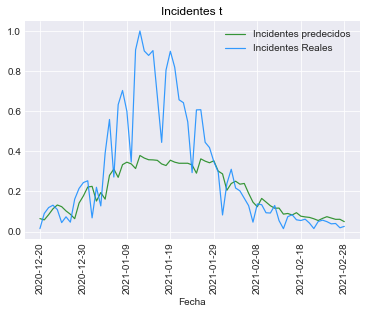

In [74]:
grafica(y_pred, y_test_3, -1)

### Predicción 7 días adelante

Calculamos las predicciones en los 7 días adelante.

In [75]:
predicciones_rf_lag3 = calcular_predicciones_lag3(optimised_rf_lag3, y_pred, X_test_3)

Mostramos en una gráfica todas las predicciones y los incidentes reales.

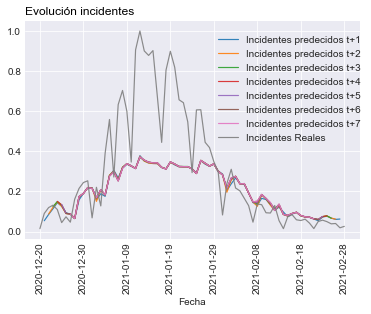

In [76]:
visualizar_predicciones(y_test_3, predicciones_rf_lag3)

Calculamos los errores y los vamos añadiendo a la lista de errores. Además se muestran las predicciones en cada instante.

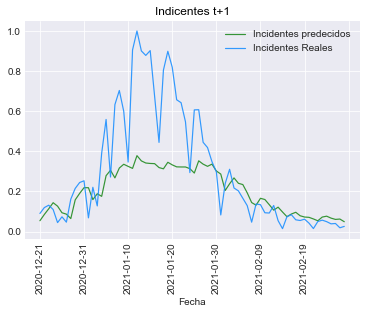

MAE = 0.15
RMSE = 0.23


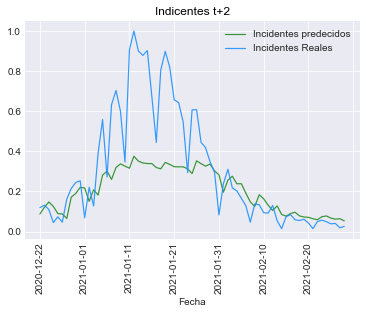

MAE = 0.15
RMSE = 0.23


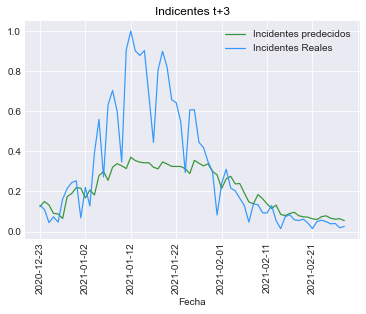

MAE = 0.15
RMSE = 0.23


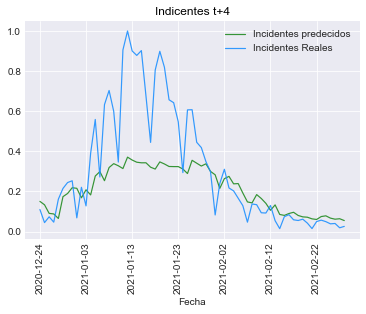

MAE = 0.15
RMSE = 0.23


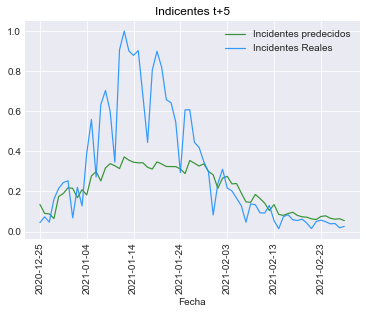

MAE = 0.15
RMSE = 0.23


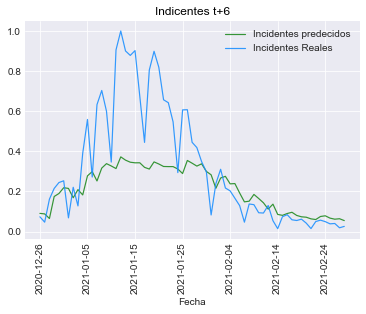

MAE = 0.15
RMSE = 0.24


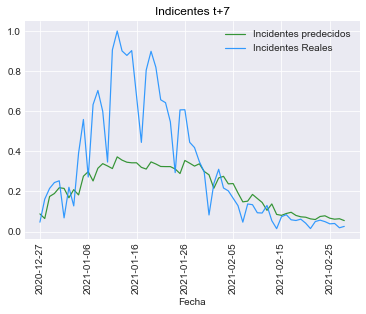

MAE = 0.16
RMSE = 0.24


In [77]:
MAE_rf, RMSE_rf = graficas_errores(predicciones_rf_lag3, y_test_3)

Añadimos los errores RMSE y MAE y después calculamos los CC de cada predicción en pasos adelante.

In [78]:
for i in range(0, len(RMSE_rf)):
    RMSEs_test_lag3_rf.append(RMSE_rf[i])
    MAEs_test_lag3_rf.append(MAE_rf[i])

In [79]:
calcular_cc(y_test_3, predicciones_rf_lag3, CCs_test_lag3_rf)

## Lag 5

In [169]:
clf_rf = search_grid(rf, grid, X_train_5, y_train_5)

In [170]:
optimised_rf = clf_rf.best_estimator_

In [171]:
clf_rf.best_params_

{'bootstrap': True,
 'max_depth': 20,
 'max_features': 5,
 'min_samples_leaf': 2,
 'min_samples_split': 8,
 'n_estimators': 100}

In [172]:
rf_results = pd.DataFrame(clf_rf.cv_results_)
rf_results.head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_bootstrap,param_max_depth,param_max_features,param_min_samples_leaf,param_min_samples_split,param_n_estimators,...,split2_train_score,split3_train_score,split4_train_score,split5_train_score,split6_train_score,split7_train_score,split8_train_score,split9_train_score,mean_train_score,std_train_score
0,0.238150,0.032929,0.015190,0.000892,True,20,2,1,4,100,...,-0.002989,-0.002695,-0.002551,-0.003324,-0.006114,-0.008909,-0.012888,-0.017250,-0.006460,0.004775
1,0.714150,0.050421,0.033534,0.007744,True,20,2,1,4,300,...,-0.002869,-0.002493,-0.002467,-0.003173,-0.005845,-0.008784,-0.012696,-0.017192,-0.006311,0.004789
2,1.208178,0.081138,0.063989,0.010854,True,20,2,1,4,500,...,-0.002908,-0.002511,-0.002490,-0.003147,-0.005818,-0.009112,-0.012635,-0.017075,-0.006328,0.004769


In [173]:
joblib.dump(optimised_rf, 'rf_lag5_escalado.pkl')

['rf_lag5_escalado.pkl']

In [80]:
optimised_rf_lag5 = joblib.load('rf_lag5_escalado.pkl')

### Predicción t

In [81]:
y_pred = optimised_rf_lag5.predict(X_test_5)

In [82]:
RMSEs_test_lag5_rf = []
MAEs_test_lag5_rf = []
CCs_test_lag5_rf = []

RMSEs_test_lag5_rf.append(RMSE(y_pred, y_test_5))
MAEs_test_lag5_rf.append(MAE(y_pred, y_test_5))
cc = round(np.corrcoef(y_test_5, y_pred)[0][1],3)
print('CC = ' + str(cc))
CCs_test_lag5_rf.append(cc)

RMSE = 0.23
MAE = 0.14
CC = 0.859


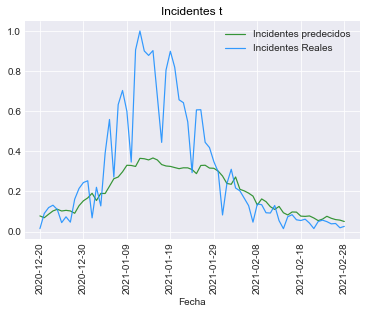

In [83]:
grafica(y_pred, y_test_5, -1)

### Predicción 7 días adelante

In [84]:
predicciones_rf_lag5 = calcular_predicciones_lag5(optimised_rf_lag5, y_pred, X_test_5)

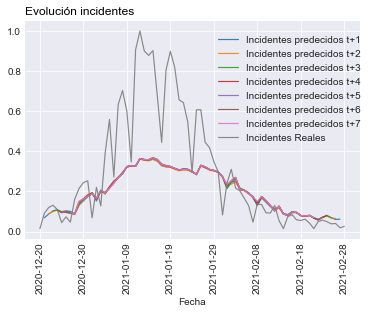

In [85]:
visualizar_predicciones(y_test_5, predicciones_rf_lag5)

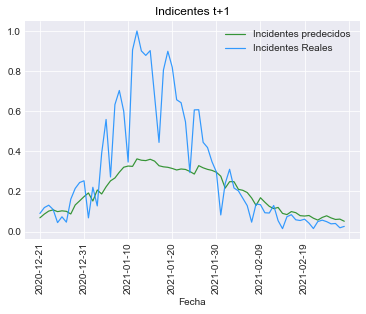

MAE = 0.15
RMSE = 0.23


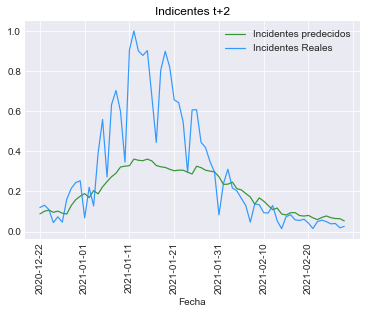

MAE = 0.15
RMSE = 0.23


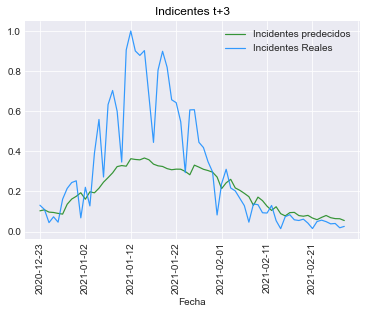

MAE = 0.15
RMSE = 0.23


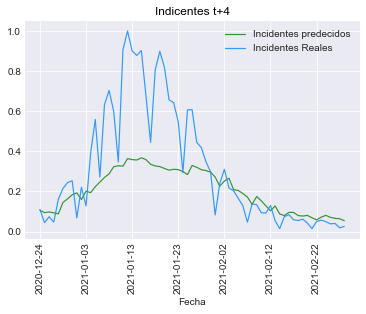

MAE = 0.15
RMSE = 0.23


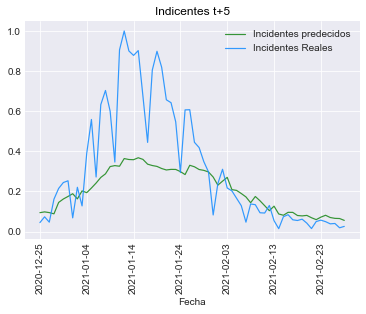

MAE = 0.15
RMSE = 0.24


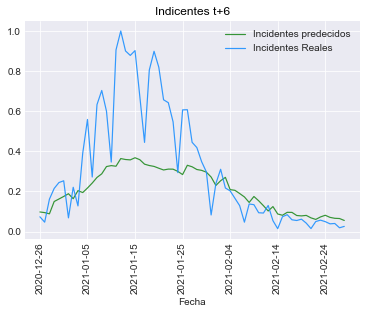

MAE = 0.16
RMSE = 0.24


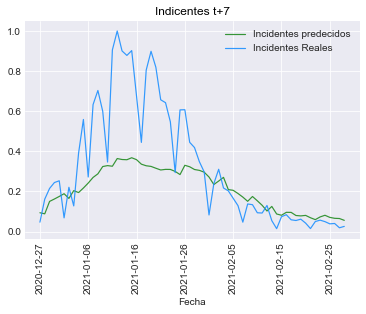

MAE = 0.16
RMSE = 0.24


In [86]:
MAE_rf, RMSE_rf = graficas_errores(predicciones_rf_lag5, y_test_5)

In [65]:
for i in range(0, len(RMSE_rf)):
    RMSEs_test_lag5_rf.append(RMSE_rf[i])
    MAEs_test_lag5_rf.append(MAE_rf[i])

In [66]:
calcular_cc(y_test_5, predicciones_rf_lag5, CCs_test_lag5_rf)

# <center> Linear Regression

Creamos una instancia del modelo.

In [15]:
regresion_lineal = LinearRegression()

## Lag 3

En este caso no hace falta hacer búsqueda de hiperparámetros. Lo único que hay que hacer es entrenar el modelo.

In [16]:
regresion_lineal.fit(X_train_3, y_train_3)

LinearRegression()

In [17]:
joblib.dump(regresion_lineal, 'regresion_lineal_lag3_escalado.pkl')

['regresion_lineal_lag3_escalado.pkl']

In [87]:
regresion_lineal_lag3 = joblib.load('regresion_lineal_lag3_escalado.pkl')

### Predicción t

In [88]:
y_pred = regresion_lineal_lag3.predict(X_test_3)

In [89]:
RMSEs_test_lag3_LR = []
MAEs_test_lag3_LR = []
CCs_test_lag3_LR = []

RMSEs_test_lag3_LR.append(RMSE(y_pred, y_test_3))
MAEs_test_lag3_LR.append(MAE(y_pred, y_test_3))
cc = round(np.corrcoef(y_test_3, y_pred)[0][1],3)
print('CC = ' + str(cc))
CCs_test_lag3_LR.append(cc)

RMSE = 0.13
MAE = 0.09
CC = 0.903


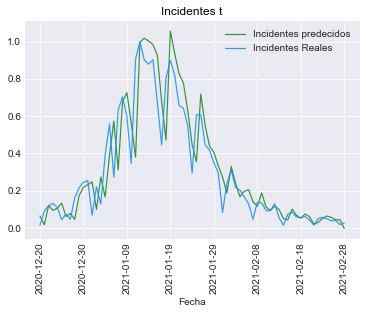

In [90]:
grafica(y_pred, y_test_3, -1)

### Predicción 7 días adelante

Creamos una lista donde irán las predicciones t+i con i = 1,...,7

In [91]:
predicciones_LR_lag3 = calcular_predicciones_lag3(regresion_lineal_lag3, y_pred, X_test_3)

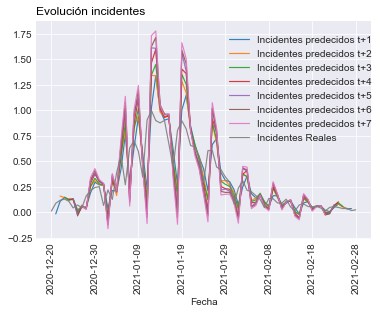

In [92]:
visualizar_predicciones(y_test_3, predicciones_LR_lag3)

Calculamos las gráficas de las predicciones así como los errores

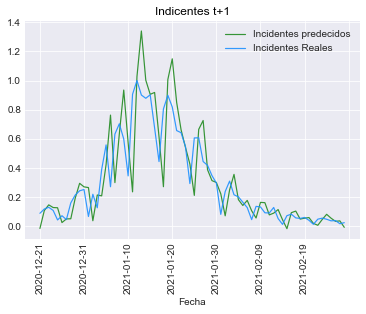

MAE = 0.11
RMSE = 0.18


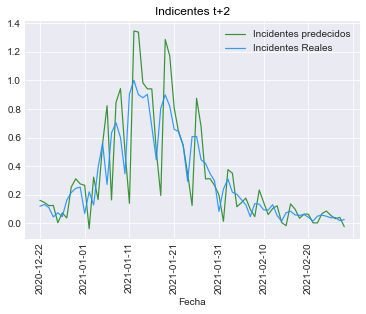

MAE = 0.14
RMSE = 0.21


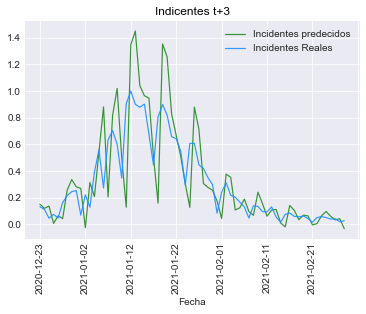

MAE = 0.15
RMSE = 0.23


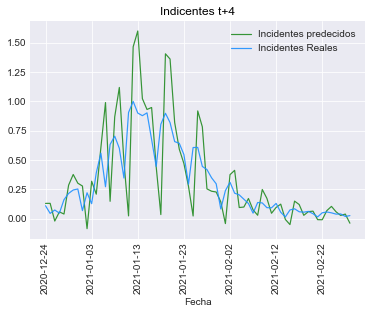

MAE = 0.17
RMSE = 0.27


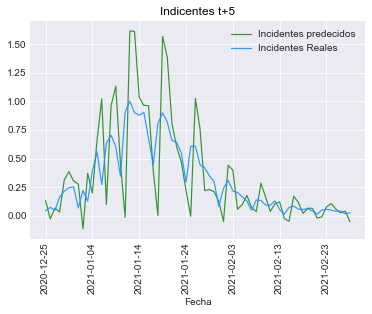

MAE = 0.19
RMSE = 0.3


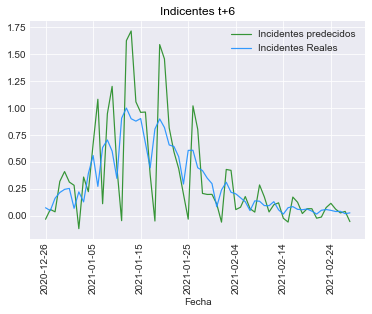

MAE = 0.21
RMSE = 0.32


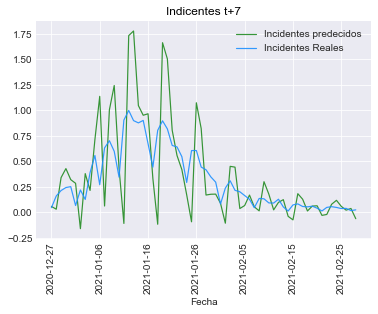

MAE = 0.23
RMSE = 0.35


In [93]:
MAE_LR, RMSE_LR = graficas_errores(predicciones_LR_lag3, y_test_3)

In [39]:
for i in range(0, len(RMSE_LR)):
    RMSEs_test_lag3_LR.append(RMSE_LR[i])
    MAEs_test_lag3_LR.append(MAE_LR[i])

In [40]:
calcular_cc(y_test_3, predicciones_rf_lag3, CCs_test_lag3_LR)

## Lag 5

In [31]:
regresion_lineal.fit(X_train_5, y_train_5)

LinearRegression()

In [32]:
joblib.dump(regresion_lineal, 'regresion_lineal_lag5_escalado.pkl')

['regresion_lineal_lag5_escalado.pkl']

In [94]:
regresion_lineal_lag5 = joblib.load('regresion_lineal_lag5_escalado.pkl')

### Predicción t

In [95]:
y_pred = regresion_lineal_lag5.predict(X_test_5)

In [96]:
RMSEs_test_lag5_LR = []
MAEs_test_lag5_LR = []
CCs_test_lag5_LR = []

RMSEs_test_lag5_LR.append(RMSE(y_pred, y_test_5))
MAEs_test_lag5_LR.append(MAE(y_pred, y_test_5))
cc = round(np.corrcoef(y_test_5, y_pred)[0][1],3)
print('CC = ' + str(cc))
CCs_test_lag5_LR.append(cc)

RMSE = 0.13
MAE = 0.08
CC = 0.907


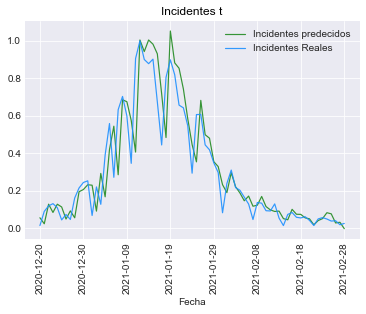

In [97]:
grafica(y_pred, y_test_5, -1)

### Predicción 7 días adelante

In [98]:
predicciones_LR_lag5 = calcular_predicciones_lag5(regresion_lineal_lag5, y_pred, X_test_5)

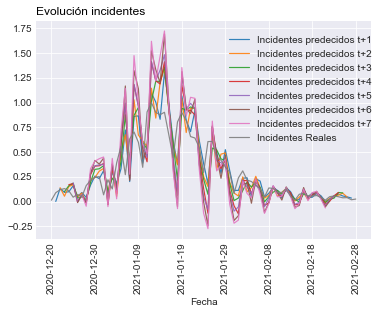

In [99]:
visualizar_predicciones(y_test_5, predicciones_LR_lag5)

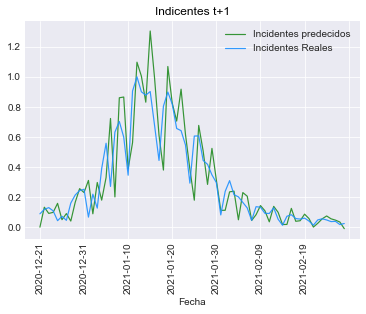

MAE = 0.11
RMSE = 0.16


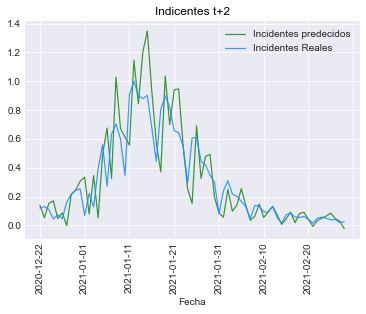

MAE = 0.12
RMSE = 0.17


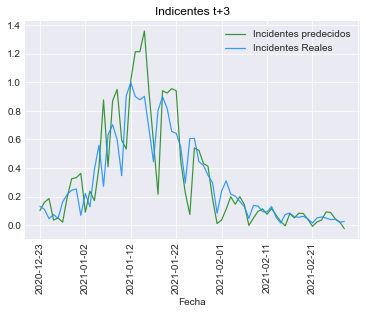

MAE = 0.13
RMSE = 0.19


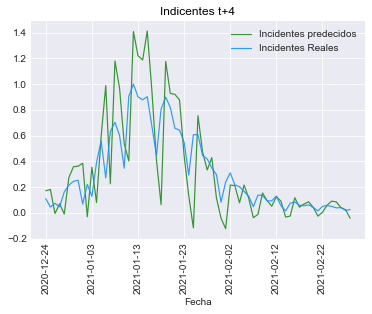

MAE = 0.17
RMSE = 0.25


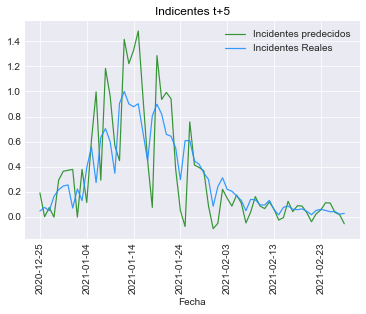

MAE = 0.17
RMSE = 0.25


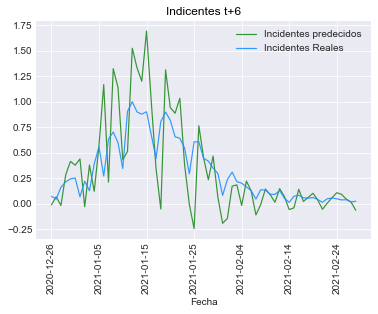

MAE = 0.21
RMSE = 0.3


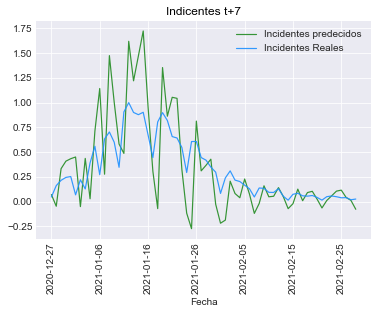

MAE = 0.23
RMSE = 0.33


In [100]:
MAE_LR, RMSE_LR = graficas_errores(predicciones_LR_lag5, y_test_5)

In [47]:
for i in range(0, len(RMSE_LR)):
    RMSEs_test_lag5_LR.append(RMSE_LR[i])
    MAEs_test_lag5_LR.append(MAE_LR[i])

In [48]:
calcular_cc(y_test_5, predicciones_LR_lag5, CCs_test_lag5_LR)

# <center> SVR 

In [121]:
svr = svm.SVR()

In [122]:
svr.get_params()

{'C': 1.0,
 'cache_size': 200,
 'coef0': 0.0,
 'degree': 3,
 'epsilon': 0.1,
 'gamma': 'scale',
 'kernel': 'rbf',
 'max_iter': -1,
 'shrinking': True,
 'tol': 0.001,
 'verbose': False}

In [123]:
grid = {'C' : [0.25, 0.5, 1, 2, 4, 8, 16, 32],
        'epsilon' : [0.1, 0.01, 0.05],
        'gamma' : ['auto'],
        'degree' : [2,3,4],
        'kernel' : ['sigmoid', 'linear', 'poly'],
        'coef0' : [0.0, 0.01, 0.05, 0.1]} 

## Lag 3

In [125]:
clf_svr = search_grid(svr, grid, X_train_3, y_train_3)

In [127]:
clf_svr.best_params_

{'C': 32,
 'coef0': 0.0,
 'degree': 2,
 'epsilon': 0.01,
 'gamma': 'auto',
 'kernel': 'linear'}

In [130]:
svr_results = pd.DataFrame(clf_svr.cv_results_)
svr_results.head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_coef0,param_degree,param_epsilon,param_gamma,param_kernel,...,split2_train_score,split3_train_score,split4_train_score,split5_train_score,split6_train_score,split7_train_score,split8_train_score,split9_train_score,mean_train_score,std_train_score
0,0.004388,0.001111,0.003491,0.002241,0.25,0,2,0.1,auto,sigmoid,...,-0.020984,-0.021895,-0.021811,-0.027055,-0.086278,-0.084233,-0.079713,-0.081937,-0.045886,0.030491
1,0.004787,0.002742,0.007481,0.008582,0.25,0,2,0.1,auto,linear,...,-0.020984,-0.021895,-0.021811,-0.027055,-0.085420,-0.070687,-0.040356,-0.057981,-0.038114,0.023457
2,0.003989,0.000892,0.006084,0.006517,0.25,0,2,0.1,auto,poly,...,-0.020984,-0.021895,-0.021811,-0.027055,-0.086582,-0.088656,-0.097484,-0.098198,-0.049762,0.035335


In [126]:
optimised_svr = clf_svr.best_estimator_

In [128]:
joblib.dump(optimised_svr, 'svr_lag3_escalado.pkl')

['svr_lag3_escalado.pkl']

In [101]:
optimised_svr_lag3 = joblib.load('svr_lag3_escalado.pkl')

### Predicción t

In [102]:
y_pred = optimised_svr_lag3.predict(X_test_3)

In [103]:
RMSEs_test_lag3_SVR = []
MAEs_test_lag3_SVR = []
CCs_test_lag3_SVR = []

RMSEs_test_lag3_SVR.append(RMSE(y_pred, y_test_3))
MAEs_test_lag3_SVR.append(MAE(y_pred, y_test_3))
cc = round(np.corrcoef(y_test_3, y_pred)[0][1],3)
print('CC = ' + str(cc))
CCs_test_lag3_SVR.append(cc)

RMSE = 0.13
MAE = 0.09
CC = 0.904


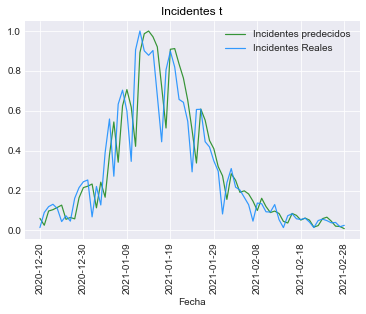

In [104]:
grafica(y_pred, y_test_3, -1)

### Predicción 7 días adelante

In [105]:
predicciones_svr_lag3 = calcular_predicciones_lag3(optimised_svr_lag3, y_pred, X_test_3)

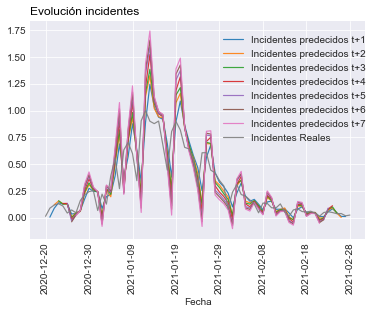

In [106]:
visualizar_predicciones(y_test_3, predicciones_svr_lag3)

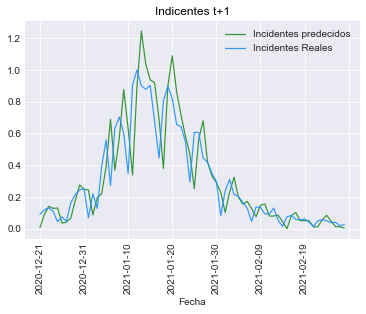

MAE = 0.1
RMSE = 0.16


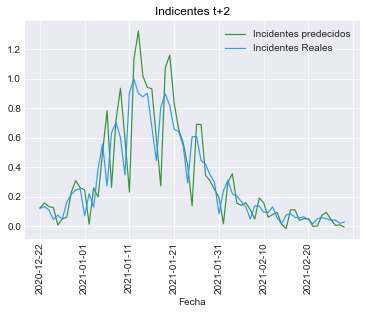

MAE = 0.12
RMSE = 0.19


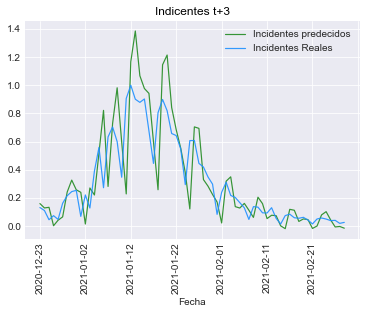

MAE = 0.13
RMSE = 0.2


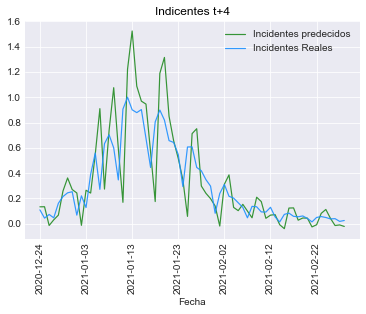

MAE = 0.15
RMSE = 0.23


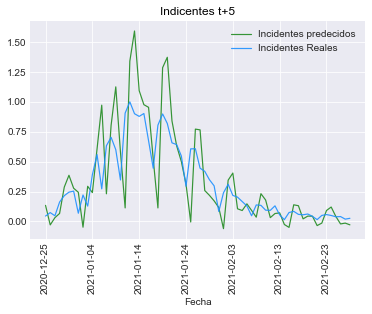

MAE = 0.17
RMSE = 0.26


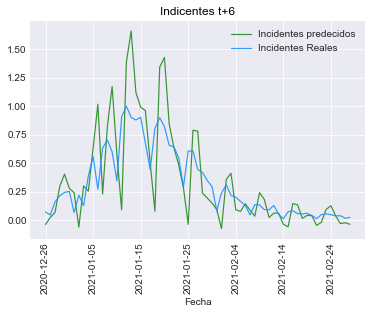

MAE = 0.18
RMSE = 0.27


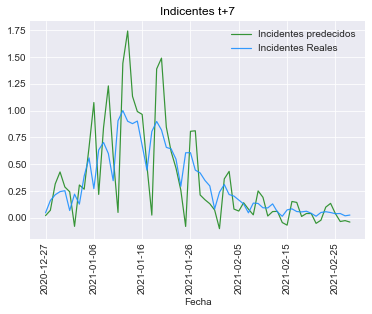

MAE = 0.2
RMSE = 0.3


In [107]:
MAE_SVR, RMSE_SVR = graficas_errores(predicciones_svr_lag3, y_test_3)

In [55]:
for i in range(0, len(RMSE_SVR)):
    RMSEs_test_lag3_SVR.append(RMSE_SVR[i])
    MAEs_test_lag3_SVR.append(MAE_SVR[i])

In [56]:
calcular_cc(y_test_3, predicciones_svr_lag3, CCs_test_lag3_SVR)

## Lag 5

In [138]:
clf_svr = search_grid(svr, grid, X_train_5, y_train_5)

In [139]:
clf_svr.best_params_

{'C': 16,
 'coef0': 0.0,
 'degree': 2,
 'epsilon': 0.01,
 'gamma': 'auto',
 'kernel': 'linear'}

In [140]:
svr_results = pd.DataFrame(clf_svr.cv_results_)
svr_results.head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_coef0,param_degree,param_epsilon,param_gamma,param_kernel,...,split2_train_score,split3_train_score,split4_train_score,split5_train_score,split6_train_score,split7_train_score,split8_train_score,split9_train_score,mean_train_score,std_train_score
0,0.006470,0.004916,0.003191,3.989541e-04,0.25,0,2,0.1,auto,sigmoid,...,-0.020972,-0.021903,-0.021816,-0.02703,-0.086462,-0.084307,-0.081021,-0.083449,-0.046131,0.030912
1,0.005087,0.001509,0.006483,6.529154e-03,0.25,0,2,0.1,auto,linear,...,-0.020972,-0.021903,-0.021816,-0.02703,-0.086055,-0.075169,-0.040656,-0.056998,-0.038495,0.024216
2,0.007779,0.008186,0.002992,9.419797e-07,0.25,0,2,0.1,auto,poly,...,-0.020972,-0.021903,-0.021816,-0.02703,-0.086306,-0.088386,-0.098377,-0.098862,-0.049800,0.035548


In [141]:
optimised_svr = clf_svr.best_estimator_

In [142]:
joblib.dump(optimised_svr, 'svr_lag5_escalado.pkl')

['svr_lag5_escalado.pkl']

In [108]:
optimised_svr_lag5 = joblib.load('svr_lag5_escalado.pkl')

### Predicción t

In [109]:
y_pred = optimised_svr_lag5.predict(X_test_5)

In [110]:
RMSEs_test_lag5_SVR = []
MAEs_test_lag5_SVR = []
CCs_test_lag5_SVR = []

RMSEs_test_lag5_SVR.append(RMSE(y_pred, y_test_5))
MAEs_test_lag5_SVR.append(MAE(y_pred, y_test_5))
cc = round(np.corrcoef(y_test_5, y_pred)[0][1],3)
print('CC = ' + str(cc))
CCs_test_lag5_SVR.append(cc)

RMSE = 0.13
MAE = 0.08
CC = 0.905


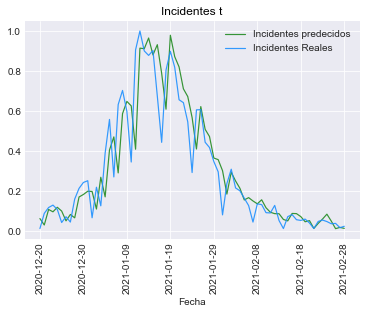

In [111]:
grafica(y_pred, y_test_5, -1)

### Predicción 7 días adelante

In [112]:
predicciones_svr_lag5 = calcular_predicciones_lag5(optimised_svr_lag5, y_pred, X_test_5)

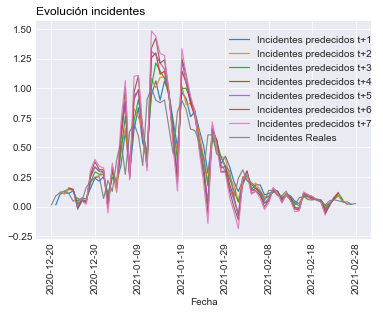

In [113]:
visualizar_predicciones(y_test_5, predicciones_svr_lag5)

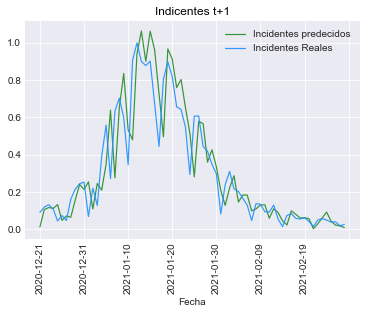

MAE = 0.09
RMSE = 0.14


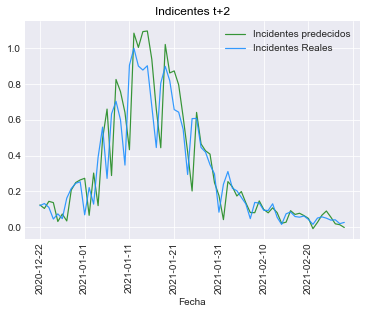

MAE = 0.1
RMSE = 0.15


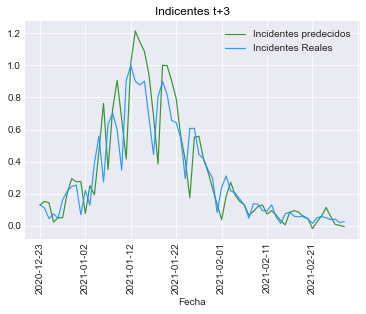

MAE = 0.11
RMSE = 0.17


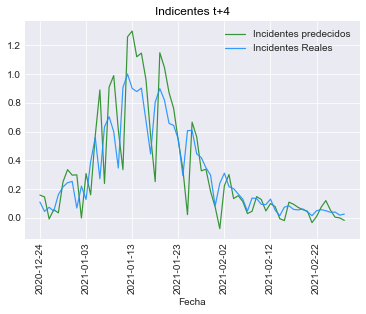

MAE = 0.14
RMSE = 0.21


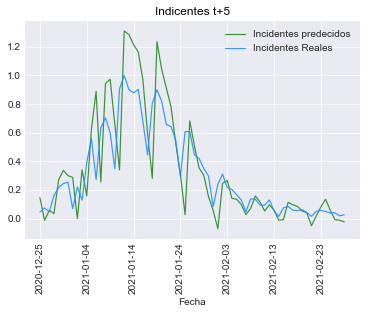

MAE = 0.14
RMSE = 0.21


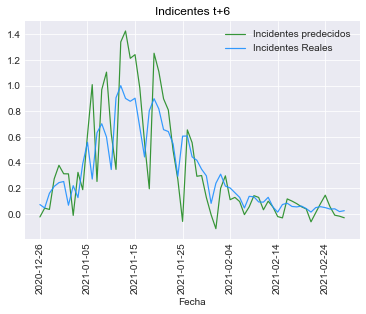

MAE = 0.16
RMSE = 0.24


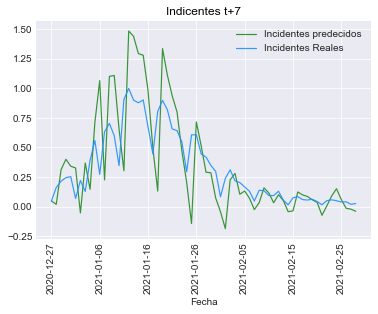

MAE = 0.19
RMSE = 0.27


In [114]:
MAE_SVR, RMSE_SVR = graficas_errores(predicciones_svr_lag5, y_test_5)

In [63]:
for i in range(0, len(RMSE_SVR)):
    RMSEs_test_lag5_SVR.append(RMSE_SVR[i])
    MAEs_test_lag5_SVR.append(MAE_SVR[i])

In [64]:
calcular_cc(y_test_5, predicciones_svr_lag5, CCs_test_lag5_SVR)

# <center> Lasso

In [43]:
lasso = Lasso(random_state = 42)

Fórmula a minimizar -> (1 / (2 * n_samples)) * ||y - Xw||^2_2 + alpha * ||w||_1

In [148]:
lasso.get_params()

{'alpha': 1.0,
 'copy_X': True,
 'fit_intercept': True,
 'max_iter': 1000,
 'normalize': False,
 'positive': False,
 'precompute': False,
 'random_state': 42,
 'selection': 'cyclic',
 'tol': 0.0001,
 'warm_start': False}

- Alpha: es el coeficiente que multiplica al factor de regularización L1 (por defecto es 1)
- Max_iter: número máximo de iteraciones (por defecto está a 1000)
- Tol: tolerancia en la optimización (por defecto es 0.0001)

In [44]:
grid = {'alpha': np.logspace(-10, 3, 200),
        'max_iter' : [1000, 3000, 5000, 7000, 10000],
        'tol' : [0.0001, 0.001, 0.01, 0.1, 0.2, 0.3, 0.5]}

## Lag 3

In [45]:
clf_lasso = search_grid(lasso, grid, X_train_3, y_train_3)

In [46]:
clf_lasso.best_params_

{'alpha': 2.768286630392067e-06, 'max_iter': 3000, 'tol': 0.001}

In [47]:
lasso_results = pd.DataFrame(clf_lasso.cv_results_)
lasso_results.head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,param_max_iter,param_tol,params,split0_test_score,split1_test_score,...,split2_train_score,split3_train_score,split4_train_score,split5_train_score,split6_train_score,split7_train_score,split8_train_score,split9_train_score,mean_train_score,std_train_score
0,0.013264,0.001003,0.003292,0.000458,1e-10,1000,0.0001,"{'alpha': 1e-10, 'max_iter': 1000, 'tol': 0.0001}",-0.017193,-0.005675,...,-0.003463,-0.00318,-0.003783,-0.006043,-0.01041,-0.017316,-0.023809,-0.031761,-0.010616,0.009749
1,0.013962,0.001945,0.003890,0.001509,1e-10,1000,0.001,"{'alpha': 1e-10, 'max_iter': 1000, 'tol': 0.001}",-0.017193,-0.005675,...,-0.003463,-0.00318,-0.003783,-0.006043,-0.01041,-0.017316,-0.023809,-0.031761,-0.010616,0.009749
2,0.015558,0.003065,0.003590,0.001111,1e-10,1000,0.01,"{'alpha': 1e-10, 'max_iter': 1000, 'tol': 0.01}",-0.017193,-0.005675,...,-0.003463,-0.00318,-0.003783,-0.006043,-0.01041,-0.017316,-0.023809,-0.031761,-0.010616,0.009749


In [48]:
optimised_lasso = clf_lasso.best_estimator_

In [49]:
joblib.dump(optimised_lasso, 'lasso_lag3_escalado.pkl')

['lasso_lag3_escalado.pkl']

In [115]:
optimised_lasso_lag3 = joblib.load('lasso_lag3_escalado.pkl')

### Predicción t

In [116]:
y_pred = optimised_lasso_lag3.predict(X_test_3)

In [86]:
RMSEs_test_lag3_lasso = []
MAEs_test_lag3_lasso = []
CCs_test_lag3_lasso = []

RMSEs_test_lag3_lasso.append(RMSE(y_pred, y_test_3))
MAEs_test_lag3_lasso.append(MAE(y_pred, y_test_3))
cc = round(np.corrcoef(y_test_3, y_pred)[0][1],3)
print('CC = ' + str(cc))
CCs_test_lag3_lasso.append(cc)

RMSE = 0.13
MAE = 0.09
CC = 0.903


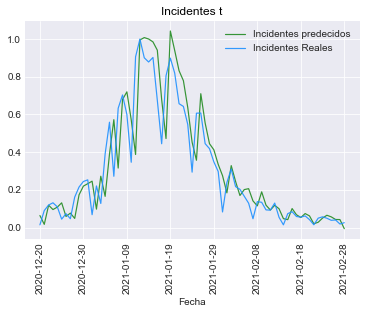

In [117]:
grafica(y_pred, y_test_3, -1)

### Predicción 7 días adelante

In [118]:
predicciones_lasso_lag3 = calcular_predicciones_lag3(optimised_lasso_lag3, y_pred, X_test_3)

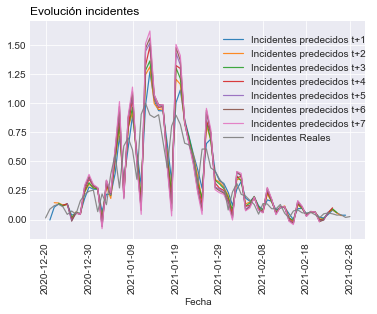

In [119]:
visualizar_predicciones(y_test_3, predicciones_lasso_lag3)

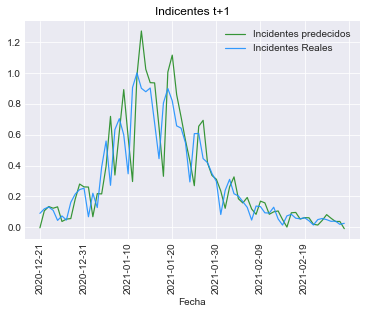

MAE = 0.1
RMSE = 0.16


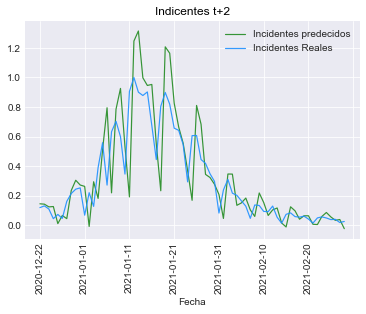

MAE = 0.13
RMSE = 0.2


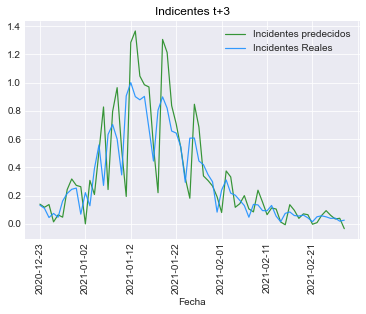

MAE = 0.13
RMSE = 0.21


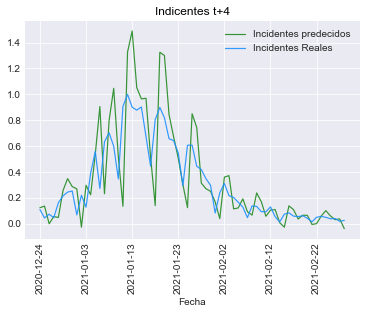

MAE = 0.15
RMSE = 0.23


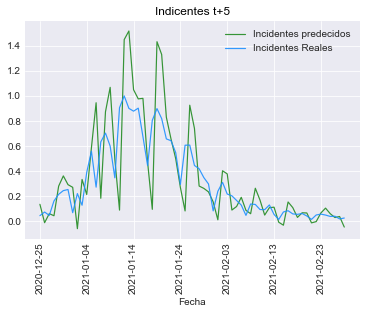

MAE = 0.17
RMSE = 0.26


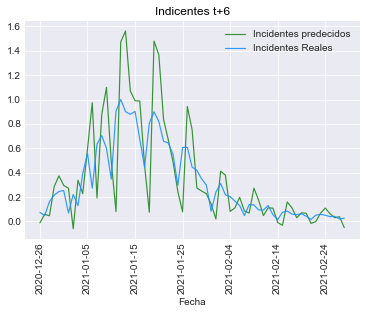

MAE = 0.17
RMSE = 0.27


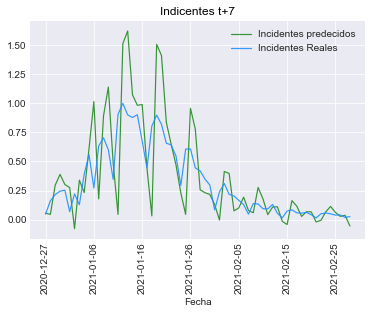

MAE = 0.19
RMSE = 0.28


In [120]:
MAE_lasso, RMSE_lasso = graficas_errores(predicciones_lasso_lag3, y_test_3)

In [71]:
for i in range(0, len(RMSE_lasso)):
    RMSEs_test_lag3_lasso.append(RMSE_lasso[i])
    MAEs_test_lag3_lasso.append(MAE_lasso[i])

In [72]:
calcular_cc(y_test_3, predicciones_lasso_lag3, CCs_test_lag3_lasso)

## Lag 5

In [62]:
clf_lasso = search_grid(lasso, grid, X_train_5, y_train_5)

In [63]:
clf_lasso.best_params_

{'alpha': 2.768286630392067e-06, 'max_iter': 5000, 'tol': 0.001}

In [64]:
lasso_results = pd.DataFrame(clf_lasso.cv_results_)
lasso_results.head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,param_max_iter,param_tol,params,split0_test_score,split1_test_score,...,split2_train_score,split3_train_score,split4_train_score,split5_train_score,split6_train_score,split7_train_score,split8_train_score,split9_train_score,mean_train_score,std_train_score
0,0.025032,0.009633,0.004290,0.001611,1e-10,1000,0.0001,"{'alpha': 1e-10, 'max_iter': 1000, 'tol': 0.0001}",-0.024179,-0.007147,...,-0.002734,-0.00264,-0.003072,-0.00512,-0.008976,-0.014611,-0.021445,-0.029719,-0.009168,0.009241
1,0.021642,0.004325,0.004389,0.001351,1e-10,1000,0.001,"{'alpha': 1e-10, 'max_iter': 1000, 'tol': 0.001}",-0.024179,-0.007147,...,-0.002734,-0.00264,-0.003072,-0.00512,-0.008976,-0.014611,-0.021445,-0.029719,-0.009168,0.009241
2,0.020645,0.007261,0.002992,0.000446,1e-10,1000,0.01,"{'alpha': 1e-10, 'max_iter': 1000, 'tol': 0.01}",-0.018363,-0.007147,...,-0.002734,-0.00264,-0.003072,-0.00512,-0.008976,-0.014611,-0.021445,-0.029719,-0.009258,0.009163


In [65]:
optimised_lasso = clf_lasso.best_estimator_

In [66]:
joblib.dump(optimised_lasso, 'lasso_lag5_escalado.pkl')

['lasso_lag5_escalado.pkl']

In [121]:
optimised_lasso_lag5 = joblib.load('lasso_lag5_escalado.pkl')

### Predicción t

In [122]:
y_pred = optimised_lasso_lag5.predict(X_test_5)

In [90]:
RMSEs_test_lag5_lasso = []
MAEs_test_lag5_lasso = []
CCs_test_lag5_lasso = []

RMSEs_test_lag5_lasso.append(RMSE(y_pred, y_test_5))
MAEs_test_lag5_lasso.append(MAE(y_pred, y_test_5))
cc = round(np.corrcoef(y_test_5, y_pred)[0][1],3)
print('CC = ' + str(cc))
CCs_test_lag5_lasso.append(cc)

RMSE = 0.13
MAE = 0.08
CC = 0.907


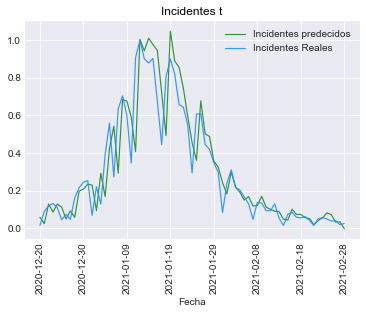

In [123]:
grafica(y_pred, y_test_5, -1)

### Predicción 7 días adelante

In [124]:
predicciones_lasso_lag5 = calcular_predicciones_lag5(optimised_lasso_lag5, y_pred, X_test_5)

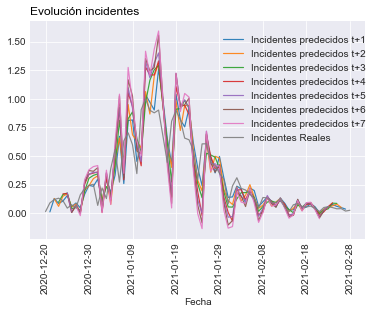

In [125]:
visualizar_predicciones(y_test_5, predicciones_lasso_lag5)

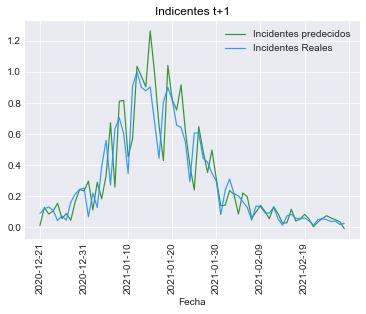

MAE = 0.09
RMSE = 0.14


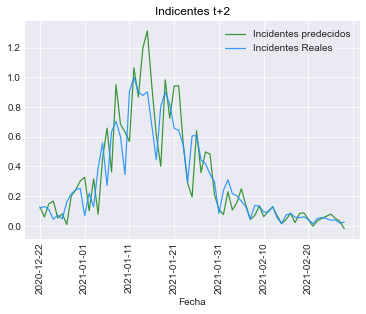

MAE = 0.11
RMSE = 0.16


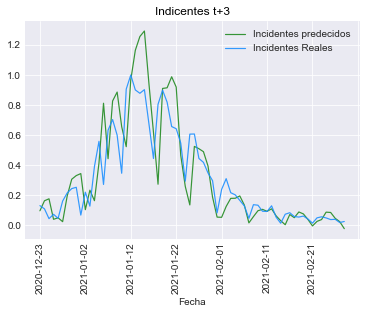

MAE = 0.12
RMSE = 0.18


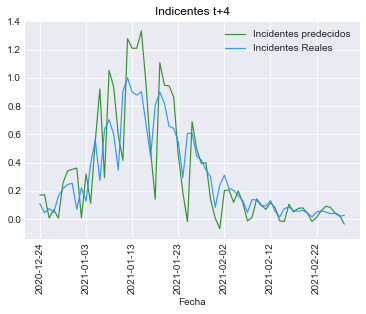

MAE = 0.15
RMSE = 0.22


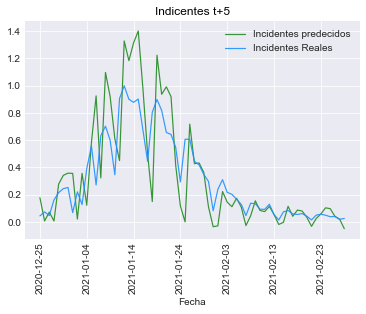

MAE = 0.16
RMSE = 0.23


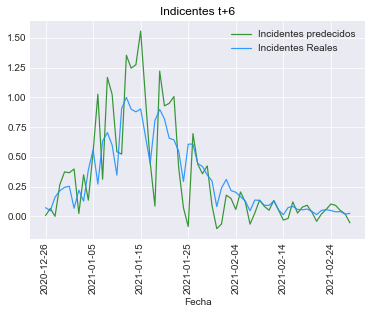

MAE = 0.17
RMSE = 0.25


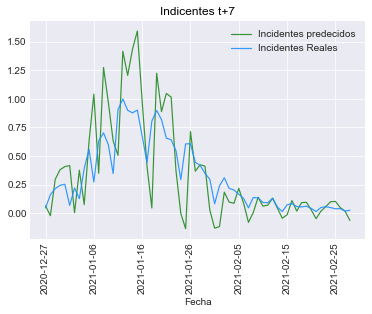

MAE = 0.19
RMSE = 0.28


In [126]:
MAE_lasso, RMSE_lasso = graficas_errores(predicciones_lasso_lag5, y_test_5)

In [79]:
for i in range(0, len(RMSE_lasso)):
    RMSEs_test_lag5_lasso.append(RMSE_lasso[i])
    MAEs_test_lag5_lasso.append(MAE_lasso[i])

In [80]:
calcular_cc(y_test_5, predicciones_lasso_lag5, CCs_test_lag5_lasso)

# <center> Gradient Boosting Regressor

La idea de este modelo es construir árboles en serie de forma que un árbol posterior intenta corregir los errores de todos
los anteriores. Parámetros importantes son la profundidad de los árboles, cuándo hacer pre-prunning (útil para evitar el overfitting) y también el ratio de aprendizaje o learning_rate que controla como se esfuerza el árbol actual en corregir los errores de los árboles anteriores. También podemos aumentar el número de árboles con el parámetro n_estimators.
Al contrario que en random forest, usar un número de árboles muy alto en gradient llevará a un modelo mucho más complejo que
puede caer en overfitting. Max_depth suele variar entre 1 y 5.

In [91]:
gbr = GradientBoostingRegressor(random_state = 42)

In [92]:
gbr.get_params()

{'alpha': 0.9,
 'ccp_alpha': 0.0,
 'criterion': 'friedman_mse',
 'init': None,
 'learning_rate': 0.1,
 'loss': 'ls',
 'max_depth': 3,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 100,
 'n_iter_no_change': None,
 'presort': 'deprecated',
 'random_state': 42,
 'subsample': 1.0,
 'tol': 0.0001,
 'validation_fraction': 0.1,
 'verbose': 0,
 'warm_start': False}

In [110]:
grid = {'n_estimators':[50, 100, 250, 500], 
        'max_depth':[3, 4, 5, 8, 10], 
        'min_samples_leaf':[4, 8, 10], 
        'max_features':[2, 3, 5]} 

## Lag 3

In [111]:
clf_gbr = search_grid(gbr, grid, X_train_3, y_train_3)

In [112]:
clf_gbr.best_params_

{'max_depth': 3, 'max_features': 5, 'min_samples_leaf': 4, 'n_estimators': 50}

In [113]:
gbr_results = pd.DataFrame(clf_gbr.cv_results_)
gbr_results.head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,param_max_features,param_min_samples_leaf,param_n_estimators,params,split0_test_score,...,split2_train_score,split3_train_score,split4_train_score,split5_train_score,split6_train_score,split7_train_score,split8_train_score,split9_train_score,mean_train_score,std_train_score
0,0.026728,0.003301,0.003591,0.000488,3,2,4,50,"{'max_depth': 3, 'max_features': 2, 'min_sampl...",-0.011109,...,-0.000984,-0.000940,-0.001136,-0.001857,-0.002766,-0.004857,-0.007097,-0.010549,-0.003219,0.003128
1,0.048071,0.005330,0.003292,0.000457,3,2,4,100,"{'max_depth': 3, 'max_features': 2, 'min_sampl...",-0.011064,...,-0.000477,-0.000515,-0.000733,-0.001076,-0.001635,-0.003014,-0.004173,-0.006568,-0.001894,0.001972
2,0.106315,0.010900,0.003392,0.000489,3,2,4,250,"{'max_depth': 3, 'max_features': 2, 'min_sampl...",-0.011034,...,-0.000093,-0.000138,-0.000268,-0.000416,-0.000569,-0.001099,-0.001645,-0.002426,-0.000677,0.000763


In [114]:
optimised_gbr = clf_gbr.best_estimator_

In [82]:
joblib.dump(optimised_gbr, 'gbr_lag3_escalado.pkl')

['gbr_lag3_escalado.pkl']

In [127]:
optimised_gbr_lag3 = joblib.load('gbr_lag3_escalado.pkl')

### Predicción t

In [128]:
y_pred = optimised_gbr_lag3.predict(X_test_3)

In [95]:
RMSEs_test_lag3_gbr = []
MAEs_test_lag3_gbr = []
CCs_test_lag3_gbr = []

RMSEs_test_lag3_gbr.append(RMSE(y_pred, y_test_3))
MAEs_test_lag3_gbr.append(MAE(y_pred, y_test_3))
cc = round(np.corrcoef(y_test_3, y_pred)[0][1],3)
print('CC = ' + str(cc))
CCs_test_lag3_gbr.append(cc)

RMSE = 0.21
MAE = 0.13
CC = 0.852


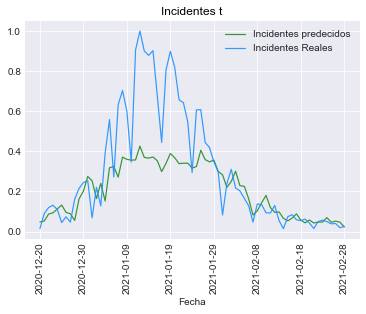

In [129]:
grafica(y_pred, y_test_3, -1)

### Predicción 7 días adelante

In [130]:
predicciones_gbr_lag3 = calcular_predicciones_lag3(optimised_gbr_lag3, y_pred, X_test_3)

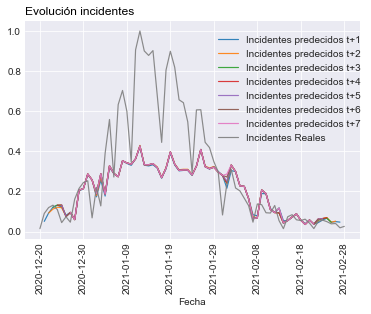

In [131]:
visualizar_predicciones(y_test_3, predicciones_gbr_lag3)

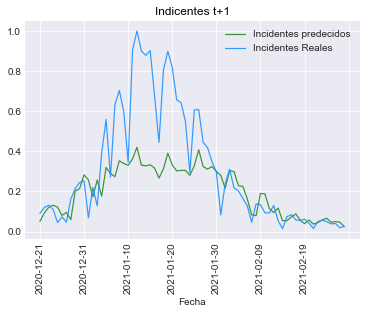

MAE = 0.14
RMSE = 0.22


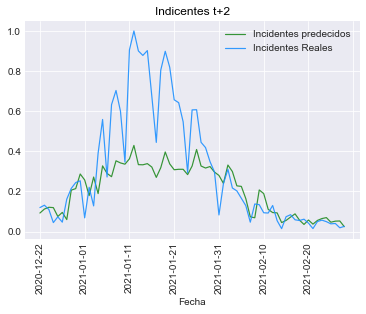

MAE = 0.14
RMSE = 0.22


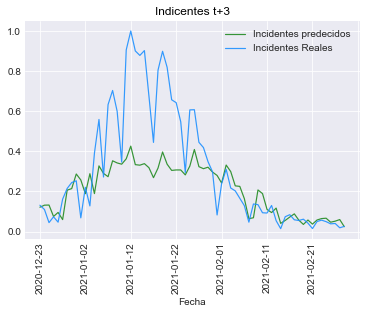

MAE = 0.14
RMSE = 0.23


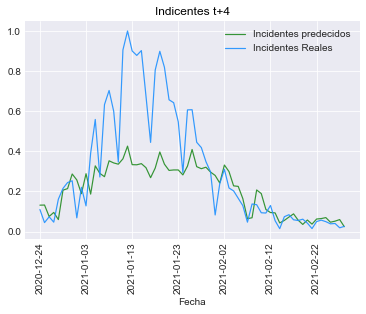

MAE = 0.14
RMSE = 0.23


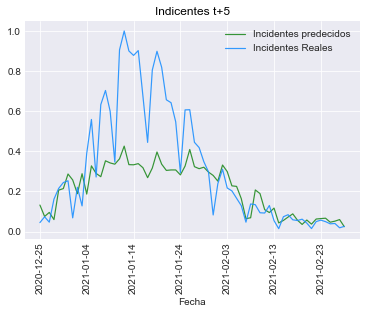

MAE = 0.15
RMSE = 0.23


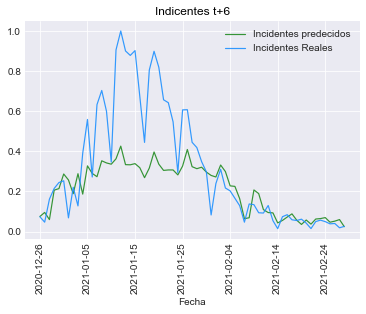

MAE = 0.15
RMSE = 0.23


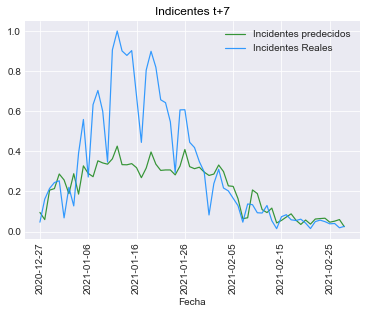

MAE = 0.15
RMSE = 0.23


In [132]:
MAE_gbr, RMSE_gbr = graficas_errores(predicciones_gbr_lag3, y_test_3)

In [87]:
for i in range(0, len(RMSE_gbr)):
    RMSEs_test_lag3_gbr.append(RMSE_gbr[i])
    MAEs_test_lag3_gbr.append(MAE_gbr[i])

In [88]:
calcular_cc(y_test_3, predicciones_gbr_lag3, CCs_test_lag3_gbr)

## Lag 5

In [94]:
clf_gbr = search_grid(gbr, grid, X_train_5, y_train_5)

In [95]:
clf_gbr.best_params_

{'max_depth': 10,
 'max_features': 5,
 'min_samples_leaf': 10,
 'n_estimators': 50}

In [96]:
gbr_results = pd.DataFrame(clf_gbr.cv_results_)
gbr_results.head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,param_max_features,param_min_samples_leaf,param_n_estimators,params,split0_test_score,...,split2_train_score,split3_train_score,split4_train_score,split5_train_score,split6_train_score,split7_train_score,split8_train_score,split9_train_score,mean_train_score,std_train_score
0,0.027028,0.004645,0.003990,0.001728,3,2,4,50,"{'max_depth': 3, 'max_features': 2, 'min_sampl...",-0.014645,...,-0.001422,-0.001333,-0.001570,-0.002522,-0.004138,-0.008360,-0.012606,-0.017716,-0.005256,0.005480
1,0.053158,0.005951,0.003590,0.000489,3,2,4,100,"{'max_depth': 3, 'max_features': 2, 'min_sampl...",-0.014442,...,-0.000582,-0.000663,-0.000868,-0.001410,-0.002275,-0.004778,-0.007014,-0.010757,-0.002930,0.003332
2,0.106315,0.012427,0.003591,0.000662,3,2,4,250,"{'max_depth': 3, 'max_features': 2, 'min_sampl...",-0.014455,...,-0.000112,-0.000146,-0.000245,-0.000469,-0.000746,-0.001507,-0.002315,-0.003828,-0.000947,0.001191


In [97]:
optimised_gbr = clf_gbr.best_estimator_

In [98]:
joblib.dump(optimised_gbr, 'gbr_lag5_escalado.pkl')

['gbr_lag5_escalado.pkl']

In [133]:
optimised_gbr_lag5 = joblib.load('gbr_lag5_escalado.pkl')

### Predicción t

In [134]:
y_pred = optimised_gbr_lag5.predict(X_test_5)

In [98]:
RMSEs_test_lag5_gbr = []
MAEs_test_lag5_gbr = []
CCs_test_lag5_gbr = []

RMSEs_test_lag5_gbr.append(RMSE(y_pred, y_test_5))
MAEs_test_lag5_gbr.append(MAE(y_pred, y_test_5))
cc = round(np.corrcoef(y_test_5, y_pred)[0][1],3)
print('CC = ' + str(cc))
CCs_test_lag5_gbr.append(cc)

RMSE = 0.21
MAE = 0.13
CC = 0.86


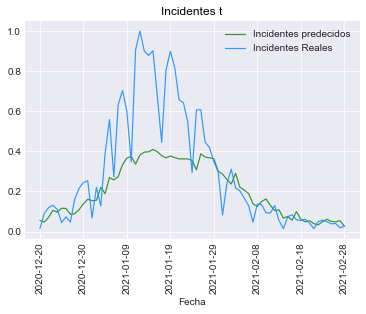

In [135]:
grafica(y_pred, y_test_5, -1)

### Predicción 7 días adelante

In [136]:
predicciones_gbr_lag5 = calcular_predicciones_lag5(optimised_gbr_lag5, y_pred, X_test_5)

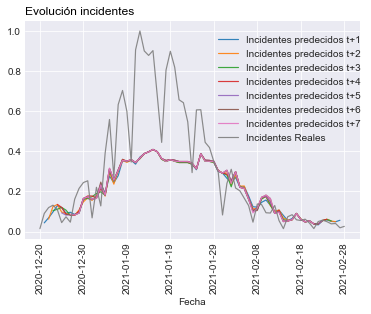

In [137]:
visualizar_predicciones(y_test_5, predicciones_gbr_lag5)

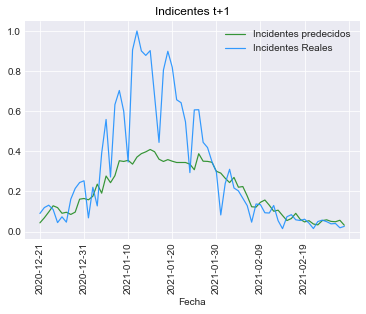

MAE = 0.14
RMSE = 0.21


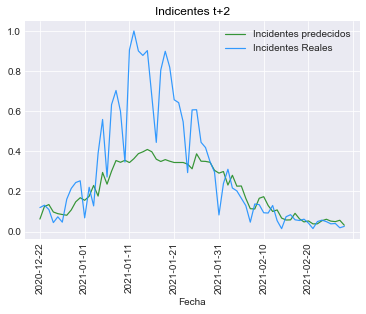

MAE = 0.14
RMSE = 0.22


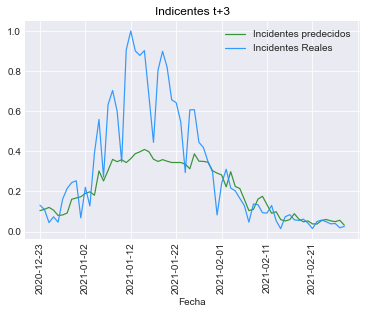

MAE = 0.14
RMSE = 0.22


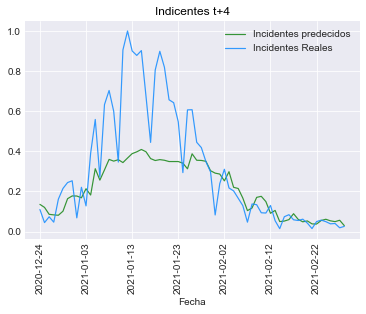

MAE = 0.14
RMSE = 0.22


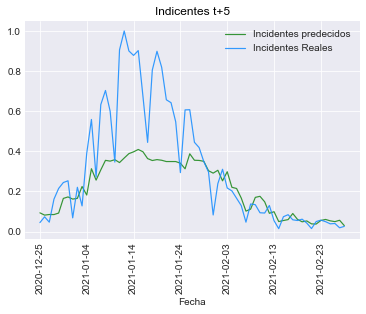

MAE = 0.14
RMSE = 0.22


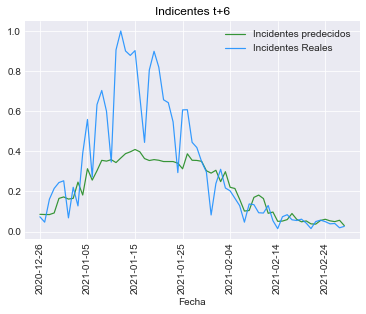

MAE = 0.14
RMSE = 0.22


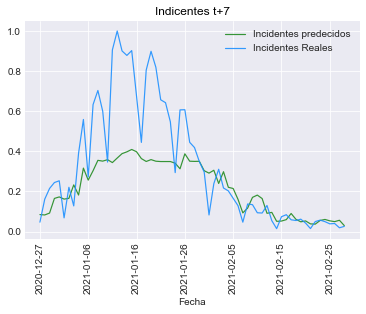

MAE = 0.14
RMSE = 0.22


In [138]:
MAE_gbr, RMSE_gbr = graficas_errores(predicciones_gbr_lag5, y_test_5)

In [95]:
for i in range(0, len(RMSE_gbr)):
    RMSEs_test_lag5_gbr.append(RMSE_gbr[i])
    MAEs_test_lag5_gbr.append(MAE_gbr[i])

In [96]:
calcular_cc(y_test_5, predicciones_gbr_lag5, CCs_test_lag5_gbr)

# <center> Elastic Net

Minimiza la función objetivo:

1 / (2 * n_samples) * ||y - Xw||^2_2 + alpha * l1_ratio * ||w||_1 + 0.5 * alpha * (1 - l1_ratio) * ||w||^2_2 =

a * ||w||_1 + 0.5 * b * ||w||_2^2 donde

alpha = a + b y l1_ratio = a / (a + b)

In [184]:
elastic_net = ElasticNet(random_state = 42)

In [249]:
grid = {'alpha' : [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 0.0, 1.0, 10.0, 100.0],
        'l1_ratio' : np.arange(0, 1, 0.01),
        'max_iter' : [10000,15000,20000],
        'tol' : [0.0001, 0.001, 0.01, 0.1, 0.2, 0.3, 0.5]}

## Lag 3

In [250]:
clf_en = search_grid(elastic_net, grid, X_train_3, y_train_3)

In [251]:
clf_en.best_params_

{'alpha': 1e-05, 'l1_ratio': 0.17, 'max_iter': 10000, 'tol': 0.001}

In [252]:
en_results = pd.DataFrame(clf_en.cv_results_)
en_results.head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,param_l1_ratio,param_max_iter,param_tol,params,split0_test_score,...,split2_train_score,split3_train_score,split4_train_score,split5_train_score,split6_train_score,split7_train_score,split8_train_score,split9_train_score,mean_train_score,std_train_score
0,0.101225,0.029870,0.003756,0.004432,1e-05,0,10000,0.0001,"{'alpha': 1e-05, 'l1_ratio': 0.0, 'max_iter': ...",-0.010726,...,-0.003562,-0.003286,-0.003884,-0.006108,-0.010456,-0.017418,-0.023895,-0.031797,-0.010722,0.009718
1,0.088894,0.018066,0.001396,0.001424,1e-05,0,10000,0.001,"{'alpha': 1e-05, 'l1_ratio': 0.0, 'max_iter': ...",-0.010726,...,-0.003562,-0.003286,-0.003884,-0.006108,-0.010456,-0.017418,-0.023895,-0.031797,-0.010722,0.009718
2,0.084987,0.022400,0.004686,0.007158,1e-05,0,10000,0.01,"{'alpha': 1e-05, 'l1_ratio': 0.0, 'max_iter': ...",-0.010726,...,-0.003562,-0.003286,-0.003884,-0.006108,-0.010456,-0.017418,-0.023895,-0.031797,-0.010722,0.009718


In [253]:
optimised_en = clf_en.best_estimator_

In [254]:
joblib.dump(optimised_en, 'en_lag3_escalado.pkl')

['en_lag3_escalado.pkl']

In [139]:
optimised_en_lag3 = joblib.load('en_lag3_escalado.pkl')

### Predicción t

In [140]:
y_pred = optimised_en_lag3.predict(X_test_3)

In [101]:
RMSEs_test_lag3_en = []
MAEs_test_lag3_en = []
CCs_test_lag3_en = []

RMSEs_test_lag3_en.append(RMSE(y_pred, y_test_3))
MAEs_test_lag3_en.append(MAE(y_pred, y_test_3))
cc = round(np.corrcoef(y_test_3, y_pred)[0][1],3)
print('CC = ' + str(cc))
CCs_test_lag3_en.append(cc)

RMSE = 0.13
MAE = 0.09
CC = 0.904


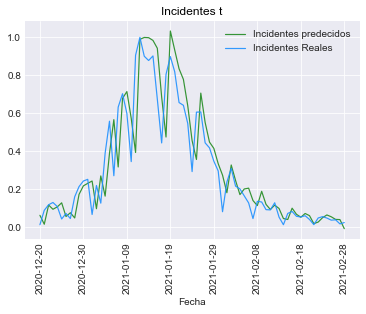

In [141]:
grafica(y_pred, y_test_3, -1)

### Predicción 7 días adelante

In [142]:
predicciones_en_lag3 = calcular_predicciones_lag3(optimised_en_lag3, y_pred, X_test_3)

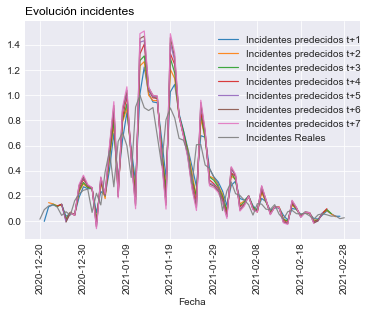

In [143]:
visualizar_predicciones(y_test_3, predicciones_en_lag3)

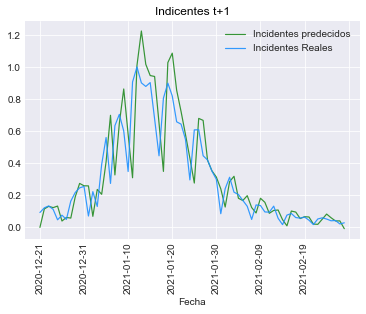

MAE = 0.1
RMSE = 0.16


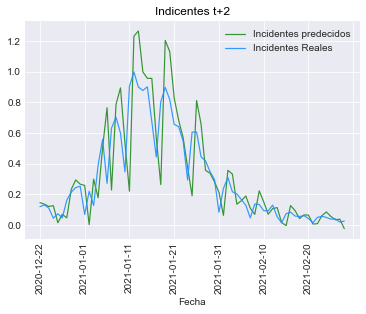

MAE = 0.12
RMSE = 0.19


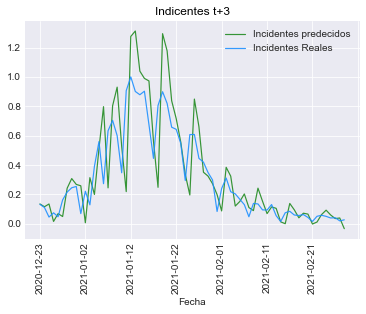

MAE = 0.13
RMSE = 0.2


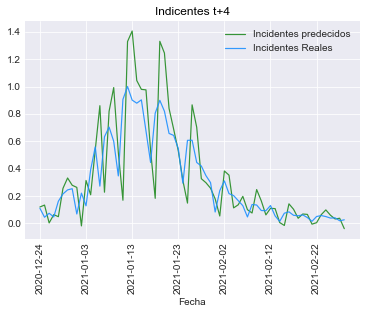

MAE = 0.14
RMSE = 0.22


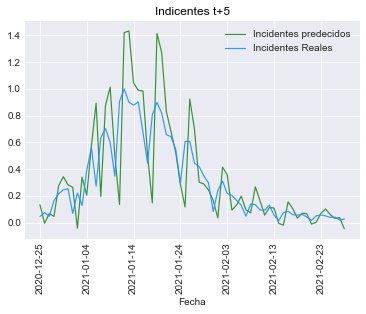

MAE = 0.16
RMSE = 0.24


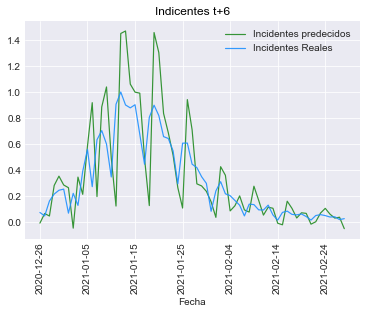

MAE = 0.17
RMSE = 0.25


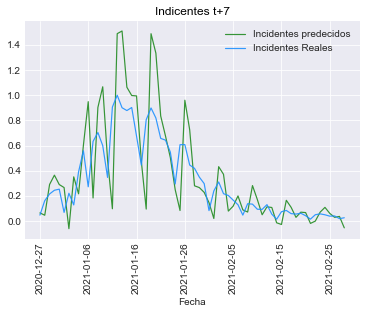

MAE = 0.17
RMSE = 0.26


In [144]:
MAE_en, RMSE_en = graficas_errores(predicciones_en_lag3, y_test_3)

In [104]:
for i in range(0, len(RMSE_en)):
    RMSEs_test_lag3_en.append(RMSE_en[i])
    MAEs_test_lag3_en.append(MAE_en[i])

In [105]:
calcular_cc(y_test_3, predicciones_en_lag3, CCs_test_lag3_en)

## Lag 5

In [264]:
clf_en = search_grid(elastic_net, grid, X_train_5, y_train_5)

In [265]:
clf_en.best_params_

{'alpha': 1e-05, 'l1_ratio': 0.13, 'max_iter': 10000, 'tol': 0.0001}

In [266]:
en_results = pd.DataFrame(clf_en.cv_results_)
en_results.head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,param_l1_ratio,param_max_iter,param_tol,params,split0_test_score,...,split2_train_score,split3_train_score,split4_train_score,split5_train_score,split6_train_score,split7_train_score,split8_train_score,split9_train_score,mean_train_score,std_train_score
0,0.136534,0.031766,0.002992,2.185142e-07,1e-05,0,10000,0.0001,"{'alpha': 1e-05, 'l1_ratio': 0.0, 'max_iter': ...",-0.013791,...,-0.003027,-0.002863,-0.003289,-0.005275,-0.008989,-0.014612,-0.021377,-0.029597,-0.009384,0.009027
1,0.144114,0.020392,0.003192,3.989941e-04,1e-05,0,10000,0.001,"{'alpha': 1e-05, 'l1_ratio': 0.0, 'max_iter': ...",-0.013791,...,-0.003027,-0.002863,-0.003289,-0.005275,-0.008989,-0.014612,-0.021377,-0.029597,-0.009384,0.009027
2,0.135238,0.031426,0.003591,1.197243e-03,1e-05,0,10000,0.01,"{'alpha': 1e-05, 'l1_ratio': 0.0, 'max_iter': ...",-0.013791,...,-0.003027,-0.002863,-0.003289,-0.005275,-0.008989,-0.014612,-0.021377,-0.029597,-0.009384,0.009027


In [267]:
optimised_en = clf_en.best_estimator_

In [268]:
joblib.dump(optimised_en, 'en_lag5_escalado.pkl')

['en_lag5_escalado.pkl']

In [145]:
optimised_en_lag5 = joblib.load('en_lag5_escalado.pkl')

### Predicción t

In [146]:
y_pred = optimised_en_lag5.predict(X_test_5)

In [105]:
RMSEs_test_lag5_en = []
MAEs_test_lag5_en = []
CCs_test_lag5_en = []

RMSEs_test_lag5_en.append(RMSE(y_pred, y_test_5))
MAEs_test_lag5_en.append(MAE(y_pred, y_test_5))
cc = round(np.corrcoef(y_test_5, y_pred)[0][1],3)
print('CC = ' + str(cc))
CCs_test_lag5_en.append(cc)

RMSE = 0.13
MAE = 0.08
CC = 0.908


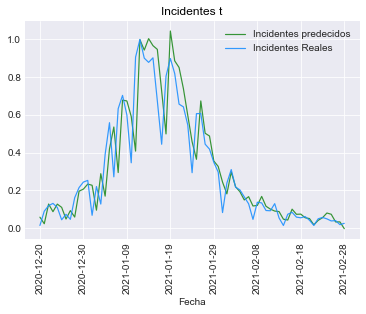

In [147]:
grafica(y_pred, y_test_5, -1)

### Predicción 7 días adelante

In [148]:
predicciones_en_lag5 = calcular_predicciones_lag5(optimised_en_lag5, y_pred, X_test_5)

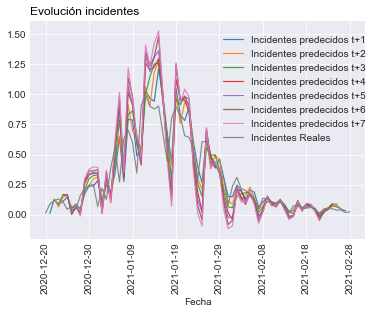

In [149]:
visualizar_predicciones(y_test_5, predicciones_en_lag5)

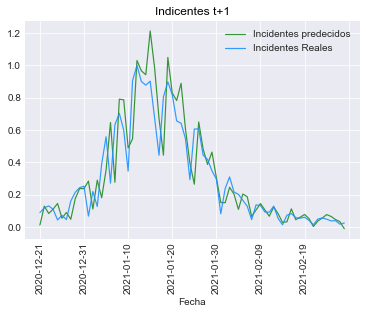

MAE = 0.09
RMSE = 0.14


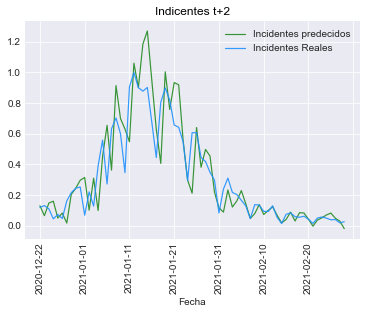

MAE = 0.1
RMSE = 0.15


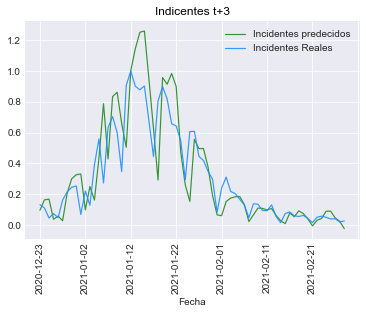

MAE = 0.11
RMSE = 0.17


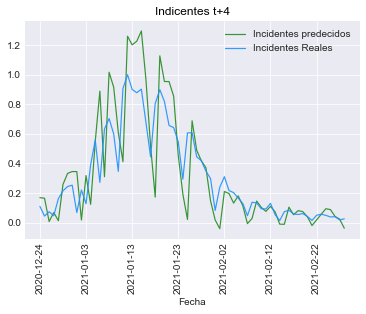

MAE = 0.14
RMSE = 0.21


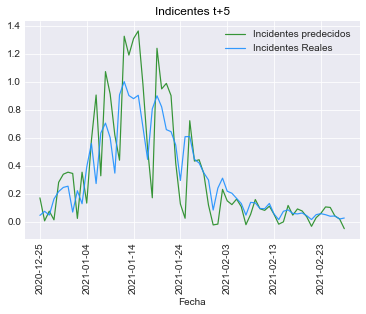

MAE = 0.15
RMSE = 0.22


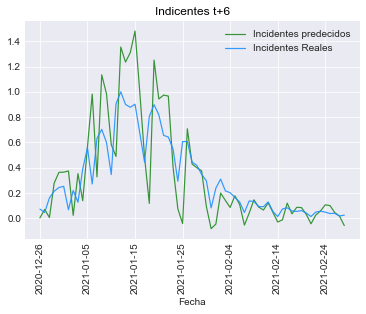

MAE = 0.17
RMSE = 0.24


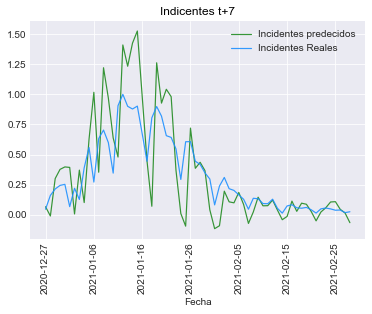

MAE = 0.19
RMSE = 0.27


In [150]:
MAE_en, RMSE_en = graficas_errores(predicciones_en_lag5, y_test_5)

In [112]:
for i in range(0, len(RMSE_en)):
    RMSEs_test_lag5_en.append(RMSE_en[i])
    MAEs_test_lag5_en.append(MAE_en[i])

In [113]:
calcular_cc(y_test_5, predicciones_en_lag5, CCs_test_lag5_en)

# Tablas de errores 

En este apartado se crean las tablas de errores para todos los modelos. Se generan dos tablas:
1. Errores en cada uno de los pliegues de la validación cruzada sobre el conjunto de train (80% de los datos)
2. Errores en las predicciones (t+i con i = 0,...,7) sobre el conjunto de test (20% de los datos)

## <center> Validación cruzada conjunto Train

Para cada uno de los modelos hemos obtenido los mejores hiperparámetros. Entrenamos los modelos usando validación cruzada de 10 pliegues (time series) y obteniendo para cada pliegue los errores RMSE, MAE y CC

In [7]:
cv = TimeSeriesSplit(n_splits = 10)

Las medidas de error que queremos obtener de los pliegues son RMSE y MAE

In [8]:
scorings = ['neg_root_mean_squared_error', 'neg_median_absolute_error']

Como se sigue un proceso de maximización entonces devuelve los errores con el signo cambiado. Simplemente multiplicando por -1 obtenemos el resultado

In [9]:
def obtener_rmse(scores):
    return (-1) * scores['test_neg_root_mean_squared_error']

In [10]:
def obtener_mae(scores):
    return (-1) * scores['test_neg_median_absolute_error']

Listas para añadir los errores de los splits para cada modelo en cada lag

In [11]:
RMSEs_train = []
MAEs_train = []

Una vez obtenidos todos los errores para cada uno de los modelos entonces creamos 6 dataframes, uno por error, tres para lag3 y otros tres para lag5. Las columnas son los modelos y las filas son los resultados de cada uno de los errores en los 10 pliegues

In [12]:
columnas = ['RF_lag3', 'RF_lag5', 'LR_lag3', 'LR_lag5', 'Lasso_lag3', 'Lasso_lag5', 'SVR_lag3', 'SVR_lag5', 'GBR_lag3', 'GBR_lag5', 'EN_lag3', 'EN_lag5' ]

In [13]:
filas_train = []
for i in range(1,11):
    filas_train.append('Fold ' + str(i))

Función para crear el dataframe con los errores de los pliegues sobre el conjunto de train

In [14]:
def crear_dataframe_error_train(columnas, filas, errores):
    # Creamos un dataframe vacío con columnas los modelos y diez filas, correspondientes a los pliegues
    df = pd.DataFrame(0, columns = columnas, index = filas)
    # Le añadimos nombre al índice
    df.index.name = 'Pliegues'
    # Colocamos los errores correspondientes a cada modelo en su columna
    for i in range(0, 12):
        df.iloc[:,i] = errores[i]
    return df

Lista para guardar los coeficientes de correlación

In [15]:
CCs_train = []

Para obtener los coeficientes de correlación en validación cruzada usamos la función split que devuelve un generador. Iterando sobre éste obtenemos los índices generados para los conjuntos de train y validación en cada split. Nos interesa saber la predicción que se hace sobre el conjunto de validación, así que nos quedamos con esos íncides.
Como el array es de la forma ([indices_train],[indices_validacion]) cogemos el segundo elemento de cada array

Para el caso de lag 3

In [30]:
# Obtenemos los índices de los pliegues sobre el conjunto de train
splits_lag3 = cv.split(X_train_3, y = None, groups = None)

# Lista para guardar los índices
indices_split_lag3 = []

# Añadimos los índices de los conjuntos de validación
for s in splits_lag3:
    indices_split_lag3.append(s[1])

Obtenemos los conjuntos con los que haremos las predicciones y la predicción correspondiente

In [239]:
# Lista con los conjuntos de validación
validacion_lag3 = []
# Lista con los conjuntos para comparar -> los llamamos test
test_lag3 = []

for i in range(0, len(indices_split_lag3)):
    # Del fold i obtenemos el primer índice del conjunto de validación
    primero = indices_split_lag3[i][0]
    # Del fold i obtenemos el último índice del conjunto de validación
    ultimo = indices_split_lag3[i][len(indices_split_lag3[i])-1]
    # Tomamos el conjunto de train que abarca todo el fold
    train = X_train_3[primero:ultimo+1]
    # Lo añadimos a la lista de conjuntos de validación
    validacion_lag3.append(train)
    # Hacemos lo mismo con la predicción -> el conjunto sobre el que queremos predecir lo obtenemos de y_train
    pred = y_train_3[primero:ultimo+1]
    # Lo añadimos a la lista de predicción real
    test_lag3.append(pred)

Para el caso de lag 5

In [240]:
# Obtenemos los índices de los pliegues sobre el conjunto de train
splits_lag5 = cv.split(X_train_5, y = None, groups = None)

# Lista para guardar los índices
indices_split_lag5 = []

# Añadimos los índices de los conjuntos de validación
for s in splits_lag5:
    indices_split_lag5.append(s[1])

Obtenemos, como hemos hecho con lag3, los conjuntos con los que haremos las predicciones

In [241]:
# Lista con los conjuntos de validación
validacion_lag5 = []
# Lista con los conjuntos para comparar -> los llamamos test
test_lag5 = []

for i in range(0, len(indices_split_lag5)):
    # Del fold i obtenemos el primer índice del conjunto de validación
    primero = indices_split_lag5[i][0]
    # Del fold i obtenemos el último índice del conjunto de validación
    ultimo = indices_split_lag5[i][len(indices_split_lag5[i])-1]
    # Tomamos el conjunto de train que abarca todo el fold
    train = X_train_5[primero:ultimo+1]
    # Lo añadimos a la lista de conjuntos de validacion
    validacion_lag5.append(train)
    # Hacemos lo mismo con la predicción -> el conjunto sobre el que queremos predecir lo obtenemos de y_train
    pred = y_train_5[primero:ultimo+1]
    # Lo añadimos a la lista de predicción real
    test_lag5.append(pred)

Función para añadir los coeficientes de correlación calculados en cada split a una lista

In [242]:
def obtener_cc_train(modelo, conjunto, prediccion):
    # Aquí irán los coeficientes de correlación
    coeficientes = []
    # Iteramos sobre el conjunto con los X de validación
    for i in range(0,len(conjunto)):
        # Predecimos con el modelo
        pred = modelo.predict(conjunto[i])
        # Comparamos con la predicción correspondiente y calculamos el CC
        coeficientes.append(round(np.corrcoef(pred, prediccion[i])[0][1],3))
    return coeficientes

Repetimos el mismo procedimiento ahora para todos los modelos. Usamos la validación cruzada para obtener el RMSE y MAE. Los añadimos a las listas correspondientes de errores para posteriormente crear el dataframe. Hacemos lo mismo con el CC, calculado a partir de los conjuntos de validación y test que se crearon antes con los índices de los conjuntos

#### Random Forest

In [5]:
optimised_rf_lag3 = joblib.load('rf_lag3_escalado.pkl')
optimised_rf_lag5 = joblib.load('rf_lag5_escalado.pkl')

In [244]:
# Obtenemos los ''scores'', donde encontraremos los errores RMSE y MAE
scores_RF_lag3 = cross_validate(optimised_rf_lag3, X_train_3, y_train_3, cv = cv, scoring = scorings)
scores_RF_lag5 = cross_validate(optimised_rf_lag5, X_train_5, y_train_5, cv = cv, scoring = scorings)

# Los añadimos a la lista
RMSEs_train.append(obtener_rmse(scores_RF_lag3))
MAEs_train.append(obtener_mae(scores_RF_lag3))

RMSEs_train.append(obtener_rmse(scores_RF_lag5))
MAEs_train.append(obtener_mae(scores_RF_lag5))

In [245]:
# Calculamos los coeficientes de correlación y los añadimos a la lista
CCs_train.append(obtener_cc_train(optimised_rf_lag3, validacion_lag3, test_lag3))
CCs_train.append(obtener_cc_train(optimised_rf_lag5, validacion_lag5, test_lag5))

#### Linear Regression

In [6]:
regresion_lineal_lag3 = joblib.load('regresion_lineal_lag3_escalado.pkl')
regresion_lineal_lag5 = joblib.load('regresion_lineal_lag5_escalado.pkl')

In [247]:
scores_LR_lag3 = cross_validate(regresion_lineal_lag3, X_train_3, y_train_3, cv = cv, scoring = scorings)
scores_LR_lag5 = cross_validate(regresion_lineal_lag5, X_train_5, y_train_5, cv = cv, scoring = scorings)

RMSEs_train.append(obtener_rmse(scores_LR_lag3))
MAEs_train.append(obtener_mae(scores_LR_lag3))

RMSEs_train.append(obtener_rmse(scores_LR_lag5))
MAEs_train.append(obtener_mae(scores_LR_lag5))

In [248]:
CCs_train.append(obtener_cc_train(regresion_lineal_lag3, validacion_lag3, test_lag3))
CCs_train.append(obtener_cc_train(regresion_lineal_lag5, validacion_lag5, test_lag5))

#### Lasso

In [7]:
optimised_lasso_lag3 = joblib.load('lasso_lag3_escalado.pkl')
optimised_lasso_lag5 = joblib.load('lasso_lag5_escalado.pkl')

In [250]:
scores_lasso_lag3 = cross_validate(optimised_lasso_lag3, X_train_3, y_train_3, cv = cv, scoring = scorings)
scores_lasso_lag5 = cross_validate(optimised_lasso_lag5, X_train_5, y_train_5, cv = cv, scoring = scorings)

RMSEs_train.append(obtener_rmse(scores_lasso_lag3))
MAEs_train.append(obtener_mae(scores_lasso_lag3))

RMSEs_train.append(obtener_rmse(scores_lasso_lag5))
MAEs_train.append(obtener_mae(scores_lasso_lag5))

In [251]:
CCs_train.append(obtener_cc_train(optimised_lasso_lag3, validacion_lag3, test_lag3))
CCs_train.append(obtener_cc_train(optimised_lasso_lag5, validacion_lag5, test_lag5))

#### SVR

In [8]:
optimised_svr_lag3 = joblib.load('svr_lag3_escalado.pkl')
optimised_svr_lag5 = joblib.load('svr_lag5_escalado.pkl')

In [253]:
scores_svr_lag3 = cross_validate(optimised_svr_lag3, X_train_3, y_train_3, cv = cv, scoring = scorings)
scores_svr_lag5 = cross_validate(optimised_svr_lag5, X_train_5, y_train_5, cv = cv, scoring = scorings)

RMSEs_train.append(obtener_rmse(scores_svr_lag3))
MAEs_train.append(obtener_mae(scores_svr_lag3))

RMSEs_train.append(obtener_rmse(scores_svr_lag5))
MAEs_train.append(obtener_mae(scores_svr_lag5))

In [254]:
CCs_train.append(obtener_cc_train(optimised_svr_lag3, validacion_lag3, test_lag3))
CCs_train.append(obtener_cc_train(optimised_svr_lag5, validacion_lag5, test_lag5))

#### Gradient Boosting Regressor

In [9]:
optimised_gbr_lag3 = joblib.load('gbr_lag3_escalado.pkl')
optimised_gbr_lag5 = joblib.load('gbr_lag5_escalado.pkl')

In [256]:
scores_gbr_lag3 = cross_validate(optimised_gbr_lag3, X_train_3, y_train_3, cv = cv, scoring = scorings)
scores_gbr_lag5 = cross_validate(optimised_gbr_lag5, X_train_5, y_train_5, cv = cv, scoring = scorings)

RMSEs_train.append(obtener_rmse(scores_gbr_lag3))
MAEs_train.append(obtener_mae(scores_gbr_lag3))

RMSEs_train.append(obtener_rmse(scores_gbr_lag5))
MAEs_train.append(obtener_mae(scores_gbr_lag5))

In [257]:
CCs_train.append(obtener_cc_train(optimised_gbr_lag3, validacion_lag3, test_lag3))
CCs_train.append(obtener_cc_train(optimised_gbr_lag5, validacion_lag5, test_lag5))

#### Elastic Net

In [10]:
optimised_en_lag3 = joblib.load('en_lag3_escalado.pkl')
optimised_en_lag5 = joblib.load('en_lag5_escalado.pkl')

In [259]:
scores_en_lag3 = cross_validate(optimised_en_lag3, X_train_3, y_train_3, cv = cv, scoring = scorings)
scores_en_lag5 = cross_validate(optimised_en_lag5, X_train_5, y_train_5, cv = cv, scoring = scorings)

RMSEs_train.append(obtener_rmse(scores_en_lag3))
MAEs_train.append(obtener_mae(scores_en_lag3))

RMSEs_train.append(obtener_rmse(scores_en_lag5))
MAEs_train.append(obtener_mae(scores_en_lag5))

In [260]:
CCs_train.append(obtener_cc_train(optimised_en_lag3, validacion_lag3, test_lag3))
CCs_train.append(obtener_cc_train(optimised_en_lag5, validacion_lag5, test_lag5))

### Creación tablas validación cruzada

Una vez obtenidas todas las medidas de error entonces creamos la tabla. Creamos una tabla por cada métrica: una para RMSE, una para MAE y una para CC

### RMSE

Creamos los dataframes con los errores y los guardamos

In [261]:
RMSE_errores_train = crear_dataframe_error_train(columnas, filas_train, RMSEs_train)
RMSE_errores_train

,RF_lag3,RF_lag5,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,GBR_lag3,GBR_lag5,EN_lag3,EN_lag5
Pliegues,,,,,,,,,,,,
Fold 1,0.010250,0.012253,0.040040,0.021895,0.010777,0.012175,0.015468,0.017608,0.009779,0.011421,0.009565,0.011302
Fold 2,0.003465,0.005035,0.006011,0.008859,0.005831,0.004163,0.006113,0.004916,0.003236,0.005702,0.005437,0.004665
Fold 3,0.002359,0.002950,0.002599,0.004666,0.002282,0.002253,0.007964,0.006088,0.002058,0.001663,0.002220,0.002200
Fold 4,0.005817,0.005213,0.008027,0.008158,0.006893,0.007117,0.012659,0.018517,0.005418,0.005386,0.006962,0.007347
Fold 5,0.019228,0.018612,0.015113,0.017661,0.014720,0.014294,0.018877,0.022049,0.018109,0.019953,0.015303,0.015526
Fold 6,0.097717,0.099564,0.030118,0.027917,0.031447,0.029454,0.031626,0.026445,0.094637,0.099538,0.031492,0.028937
Fold 7,0.054043,0.054168,0.047621,0.046455,0.048174,0.044944,0.050317,0.046399,0.049422,0.054665,0.048253,0.045141
Fold 8,0.117732,0.113723,0.064359,0.061369,0.063967,0.061773,0.066249,0.059950,0.118328,0.118405,0.064465,0.062454
Fold 9,0.124888,0.141807,0.085793,0.091884,0.085716,0.091056,0.089009,0.093796,0.121939,0.142605,0.085260,0.091053


In [133]:
RMSE_errores_train.to_csv(path_or_buf = '../Datos_preprocesados/RMSE_errores_train.csv')

In [122]:
RMSE_errores_train = read_csv('../Datos_preprocesados/RMSE_errores_train.csv', encoding='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
RMSE_errores_train = RMSE_errores_train.set_index('Pliegues')

### MAE

In [262]:
MAE_errores_train = crear_dataframe_error_train(columnas, filas_train, MAEs_train)
MAE_errores_train

,RF_lag3,RF_lag5,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,GBR_lag3,GBR_lag5,EN_lag3,EN_lag5
Pliegues,,,,,,,,,,,,
Fold 1,0.008462,0.011392,0.032479,0.014992,0.007227,0.007082,0.012623,0.017494,0.007774,0.009879,0.006476,0.005981
Fold 2,0.003400,0.005021,0.004186,0.003734,0.004024,0.002734,0.005366,0.003984,0.003021,0.005115,0.003658,0.003443
Fold 3,0.001714,0.002173,0.001866,0.003266,0.001329,0.001685,0.005990,0.004277,0.001440,0.001243,0.001306,0.001632
Fold 4,0.002247,0.002934,0.003994,0.002763,0.002256,0.002159,0.007597,0.010134,0.001828,0.001652,0.001959,0.002001
Fold 5,0.012167,0.013229,0.011721,0.007150,0.011192,0.012083,0.014557,0.018390,0.012484,0.013561,0.012501,0.012333
Fold 6,0.084448,0.087158,0.016943,0.016096,0.017917,0.016959,0.021310,0.012787,0.082231,0.087985,0.020494,0.016918
Fold 7,0.033824,0.033456,0.026278,0.026127,0.025823,0.027261,0.034723,0.028557,0.022534,0.032382,0.026455,0.025546
Fold 8,0.065309,0.056947,0.036142,0.032730,0.035894,0.033170,0.040139,0.031767,0.074404,0.061051,0.037323,0.032217
Fold 9,0.098532,0.118379,0.052798,0.042889,0.055291,0.043395,0.059637,0.043899,0.099885,0.115925,0.054401,0.042336


In [136]:
MAE_errores_train.to_csv(path_or_buf = '../Datos_preprocesados/MAE_errores_train.csv')

In [123]:
MAE_errores_train = read_csv('../Datos_preprocesados/MAE_errores_train.csv', encoding='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
MAE_errores_train = MAE_errores_train.set_index('Pliegues')

## CC

In [263]:
CC_train = crear_dataframe_error_train(columnas, filas_train, CCs_train)
CC_train

,RF_lag3,RF_lag5,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,GBR_lag3,GBR_lag5,EN_lag3,EN_lag5
Pliegues,,,,,,,,,,,,
Fold 1,0.660,0.851,0.396,0.465,0.431,0.433,0.485,0.465,0.592,0.875,0.458,0.450
Fold 2,0.725,0.647,0.065,-0.042,0.160,0.047,0.245,-0.009,0.269,0.734,0.202,0.109
Fold 3,0.866,0.907,0.467,0.556,0.486,0.571,0.491,0.553,0.646,0.895,0.497,0.571
Fold 4,0.926,0.934,0.337,0.433,0.320,0.445,0.336,0.535,0.871,0.942,0.315,0.442
Fold 5,0.863,0.889,0.568,0.601,0.561,0.602,0.689,0.748,0.786,0.981,0.571,0.598
Fold 6,0.928,0.932,0.793,0.803,0.796,0.803,0.824,0.826,0.938,0.985,0.796,0.802
Fold 7,0.837,0.910,0.517,0.583,0.508,0.600,0.477,0.690,0.909,0.976,0.501,0.598
Fold 8,0.943,0.944,0.888,0.913,0.887,0.910,0.860,0.873,0.966,0.981,0.884,0.907
Fold 9,0.933,0.948,0.864,0.885,0.862,0.879,0.817,0.811,0.989,0.981,0.861,0.879


In [58]:
CC_train.to_csv(path_or_buf = '../Datos_preprocesados/CC_train.csv')

In [124]:
CC_train = read_csv('../Datos_preprocesados/CC_train.csv', encoding='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
CC_train = CC_train.set_index('Pliegues')

## <center> Predicciones en Test

Ahora calculamos las otras tablas, las de los errores con las predicciones sobre el conjunto de test

In [125]:
columnas = ['RF_lag3', 'RF_lag5', 'LR_lag3', 'LR_lag5', 'Lasso_lag3', 'Lasso_lag5', 'SVR_lag3', 'SVR_lag5', 'GBR_lag3', 'GBR_lag5', 'EN_lag3', 'EN_lag5' ]

Las filas son las predicciones

In [126]:
filas_test = []
for i in range(1,9):
    if i-1 == 0:
        filas_test.append('Prediccion t')
    else:
        filas_test.append('Prediccion t+' + str(i-1))

Función para crear el dataframe de los errores en las predicciones sobre el conjunto de test. Las columnas son los modelos y las filas las predicciones

In [127]:
def crear_dataframe_error_test(columnas, filas, errores):
    # Creamos un dataframe vacío con columnas los modelos e índice las filas (predicciones)
    df = pd.DataFrame(0, columns = columnas, index = filas)
    # Añadimos nombre al índice
    df.index.name = 'Predicciones'
    i = 0
    # Para cada columna (modelo) añadimos los errores correspondientes
    for c in df.columns:
        df[c] = errores[i]
        i = i+1
    return df

Ya podemos crear las tablas. De nuevo, generamos una tabla para cada métrica. Recordar que los errores en test ya fueron almacenados cuando se hizo la predicción de los modelos sobre el conjunto de test anteriormente. Solo tenemos que guardar todas las predicciones en una lista y generar el dataframe correspondiente con la función anterior

### RMSE

Añadimos los errores RMSE que se calcularon para cada modelo. Tendremos una lista de listas, donde habrá 12 elementos (todos los modelos) cuyos elementos son listas con 8 errores (las predicciones t+i con i = 0,...,7)

In [122]:
RMSEs_test = []
RMSEs_test.append(RMSEs_test_lag3_rf)
RMSEs_test.append(RMSEs_test_lag5_rf)
RMSEs_test.append(RMSEs_test_lag3_LR)
RMSEs_test.append(RMSEs_test_lag5_LR)
RMSEs_test.append(RMSEs_test_lag3_lasso)
RMSEs_test.append(RMSEs_test_lag5_lasso)
RMSEs_test.append(RMSEs_test_lag3_SVR)
RMSEs_test.append(RMSEs_test_lag5_SVR)
RMSEs_test.append(RMSEs_test_lag3_gbr)
RMSEs_test.append(RMSEs_test_lag5_gbr)
RMSEs_test.append(RMSEs_test_lag3_en)
RMSEs_test.append(RMSEs_test_lag5_en)

Se almacenan en un fichero de texto para no tener que realizar toda la ejecución de cálculo de errores

In [128]:
with open('../Datos_preprocesados/RMSEs_test.txt', 'w') as f:
    for item in RMSEs_test:
        f.write("%s\n" % item)

Finalmente creamos el dataframe

In [123]:
RMSE_errores_test = crear_dataframe_error_test(columnas, filas_test, RMSEs_test)
RMSE_errores_test

,RF_lag3,RF_lag5,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,GBR_lag3,GBR_lag5,EN_lag3,EN_lag5
Predicciones,,,,,,,,,,,,
Prediccion t,0.22,0.23,0.13,0.13,0.13,0.13,0.13,0.13,0.21,0.21,0.13,0.13
Prediccion t+1,0.23,0.23,0.18,0.16,0.16,0.14,0.16,0.14,0.22,0.21,0.16,0.14
Prediccion t+2,0.23,0.23,0.21,0.17,0.20,0.16,0.19,0.15,0.22,0.22,0.19,0.15
Prediccion t+3,0.23,0.23,0.23,0.19,0.21,0.18,0.20,0.17,0.23,0.22,0.20,0.17
Prediccion t+4,0.23,0.23,0.27,0.25,0.23,0.22,0.23,0.21,0.23,0.22,0.22,0.21
Prediccion t+5,0.23,0.24,0.30,0.25,0.26,0.23,0.26,0.21,0.23,0.22,0.24,0.22
Prediccion t+6,0.24,0.24,0.32,0.30,0.27,0.25,0.27,0.24,0.23,0.22,0.25,0.24
Prediccion t+7,0.24,0.24,0.35,0.33,0.28,0.28,0.30,0.27,0.23,0.22,0.26,0.27


In [124]:
RMSE_errores_test.to_csv(path_or_buf = '../Datos_preprocesados/RMSE_errores_test.csv')

In [112]:
RMSE_errores_test = read_csv('../Datos_preprocesados/RMSE_errores_test.csv', encoding='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
RMSE_errores_test = RMSE_errores_test.set_index('Predicciones')

### MAE

In [129]:
MAEs_test = []
MAEs_test.append(MAEs_test_lag3_rf)
MAEs_test.append(MAEs_test_lag5_rf)
MAEs_test.append(MAEs_test_lag3_LR)
MAEs_test.append(MAEs_test_lag5_LR)
MAEs_test.append(MAEs_test_lag3_lasso)
MAEs_test.append(MAEs_test_lag5_lasso)
MAEs_test.append(MAEs_test_lag3_SVR)
MAEs_test.append(MAEs_test_lag5_SVR)
MAEs_test.append(MAEs_test_lag3_gbr)
MAEs_test.append(MAEs_test_lag5_gbr)
MAEs_test.append(MAEs_test_lag3_en)
MAEs_test.append(MAEs_test_lag5_en)

In [130]:
with open('../Datos_preprocesados/MAEs_test.txt', 'w') as f:
    for item in MAEs_test:
        f.write("%s\n" % item)

In [220]:
MAE_errores_test = crear_dataframe_error_test(columnas, filas_test, MAEs_test)
MAE_errores_test

,RF_lag3,RF_lag5,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,GBR_lag3,GBR_lag5,EN_lag3,EN_lag5
Predicciones,,,,,,,,,,,,
Prediccion t,0.14,0.14,0.09,0.08,0.09,0.08,0.09,0.08,0.13,0.13,0.09,0.08
Prediccion t+1,0.15,0.15,0.11,0.11,0.10,0.09,0.10,0.09,0.14,0.14,0.10,0.09
Prediccion t+2,0.15,0.15,0.14,0.12,0.13,0.11,0.12,0.10,0.14,0.14,0.12,0.10
Prediccion t+3,0.15,0.15,0.15,0.13,0.13,0.12,0.13,0.11,0.14,0.14,0.13,0.11
Prediccion t+4,0.15,0.15,0.17,0.17,0.15,0.15,0.15,0.14,0.14,0.14,0.14,0.14
Prediccion t+5,0.15,0.15,0.19,0.17,0.17,0.16,0.17,0.14,0.15,0.14,0.16,0.15
Prediccion t+6,0.15,0.16,0.21,0.21,0.17,0.17,0.18,0.16,0.15,0.14,0.17,0.17
Prediccion t+7,0.16,0.16,0.23,0.23,0.19,0.19,0.20,0.19,0.15,0.14,0.17,0.19


In [221]:
MAE_errores_test.to_csv(path_or_buf = '../Datos_preprocesados/MAE_errores_test.csv')

In [10]:
MAE_errores_test = read_csv('../Datos_preprocesados/MAE_errores_test.csv', encoding='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
MAE_errores_test = MAE_errores_test.set_index('Predicciones')

### CC

In [132]:
CCs_test = []
CCs_test.append(CCs_test_lag3_rf)
CCs_test.append(CCs_test_lag5_rf)
CCs_test.append(CCs_test_lag3_LR)
CCs_test.append(CCs_test_lag5_LR)
CCs_test.append(CCs_test_lag3_lasso)
CCs_test.append(CCs_test_lag5_lasso)
CCs_test.append(CCs_test_lag3_SVR)
CCs_test.append(CCs_test_lag5_SVR)
CCs_test.append(CCs_test_lag3_gbr)
CCs_test.append(CCs_test_lag5_gbr)
CCs_test.append(CCs_test_lag3_en)
CCs_test.append(CCs_test_lag5_en)

In [134]:
with open('../Datos_preprocesados/CCs_test.txt', 'w') as f:
    for item in CCs_test:
        f.write("%s\n" % item)

In [223]:
CC_test = crear_dataframe_error_test(columnas, filas_test, CCs_test)
CC_test

,RF_lag3,RF_lag5,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,GBR_lag3,GBR_lag5,EN_lag3,EN_lag5
Predicciones,,,,,,,,,,,,
Prediccion t,0.847,0.859,0.903,0.907,0.903,0.907,0.904,0.905,0.852,0.860,0.904,0.908
Prediccion t+1,0.841,0.861,0.841,0.876,0.865,0.894,0.868,0.896,0.832,0.861,0.872,0.901
Prediccion t+2,0.838,0.862,0.838,0.870,0.835,0.881,0.842,0.890,0.830,0.859,0.846,0.888
Prediccion t+3,0.837,0.861,0.837,0.850,0.835,0.862,0.839,0.875,0.824,0.861,0.844,0.869
Prediccion t+4,0.836,0.861,0.836,0.803,0.807,0.829,0.810,0.840,0.824,0.857,0.822,0.840
Prediccion t+5,0.835,0.859,0.835,0.813,0.790,0.834,0.788,0.845,0.822,0.855,0.807,0.840
Prediccion t+6,0.833,0.857,0.833,0.774,0.785,0.817,0.778,0.823,0.819,0.850,0.802,0.827
Prediccion t+7,0.831,0.855,0.831,0.762,0.767,0.799,0.757,0.801,0.815,0.850,0.788,0.809


In [224]:
CC_test.to_csv(path_or_buf = '../Datos_preprocesados/CC_test.csv')

In [13]:
CC_test = read_csv('../Datos_preprocesados/CC_test.csv', encoding='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
CC_test = CC_test.set_index('Predicciones')

# Visualización gráficas sobre train

En este apartado final se visualizan las gráficas en los 7 pasos adelante generadas por la predicción sobre el conjunto de entrenamiento. Esto nos servirá para detectar posibles casos de overfitting.

Añadimos los modelos entrenados a una lista y generamos los nombres de los modelos para visualizar las gráficas

In [151]:
modelos = []
modelos.append(optimised_rf_lag3)
modelos.append(optimised_rf_lag5)
modelos.append(regresion_lineal_lag3)
modelos.append(regresion_lineal_lag5)
modelos.append(optimised_lasso_lag3)
modelos.append(optimised_lasso_lag5)
modelos.append(optimised_svr_lag3)
modelos.append(optimised_svr_lag5)
modelos.append(optimised_gbr_lag3)
modelos.append(optimised_gbr_lag5)
modelos.append(optimised_en_lag3)
modelos.append(optimised_en_lag5)

nombres = ['RF Lag 3', 'RF Lag 5','LR Lag3', 'LR Lag5', 'Lasso Lag3', 'Lasso Lag5', 'SVR Lag3', 'SVR Lag5', 'GBR Lag 3', 'GBR Lag 5', 'EN Lag3', 'EN Lag5']

Para cada modelo, predecimos sobre el conjunto de train (80% de los datos). Lo visualizamos y a partir de ese resultado, obtenemos las predicciones en los siete pasos adelante, tal y como hicimos con el conjunto de test mediante la función calcular_predicciones. Finalmente visualizamos las predicciones

Gráficas para RF Lag 3


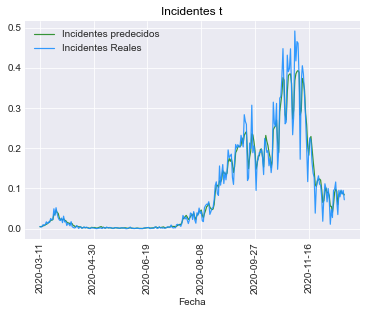

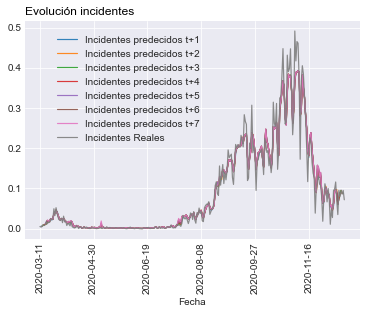

Gráficas para RF Lag 5


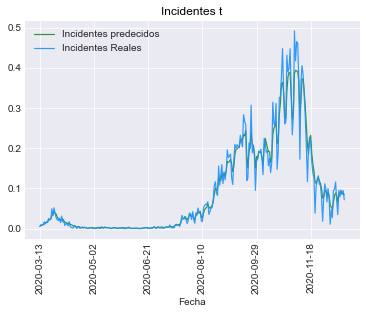

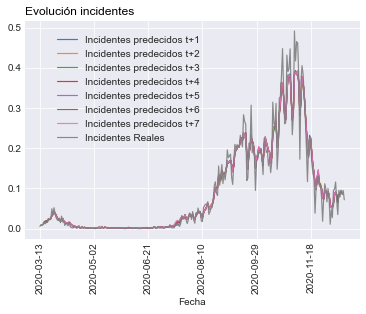

Gráficas para LR Lag3


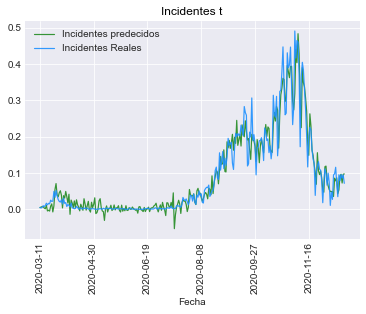

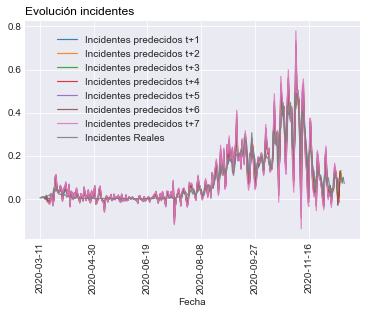

Gráficas para LR Lag5


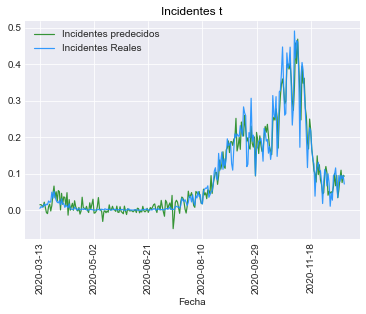

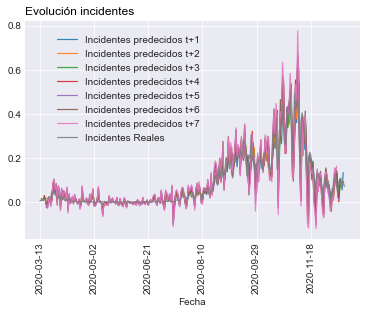

Gráficas para Lasso Lag3


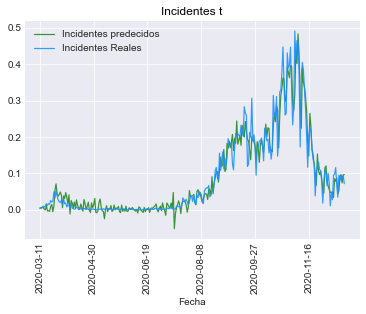

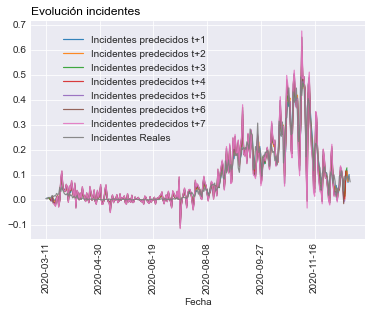

Gráficas para Lasso Lag5


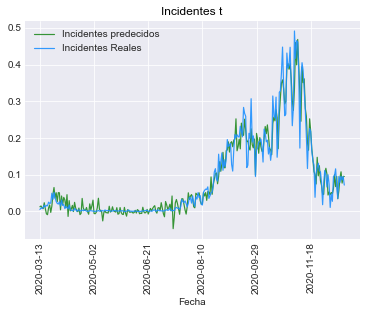

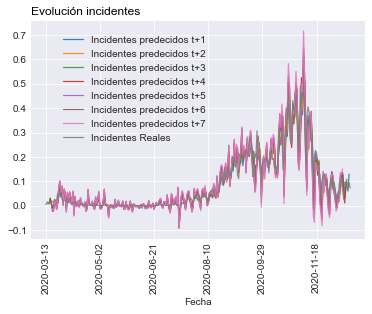

Gráficas para SVR Lag3


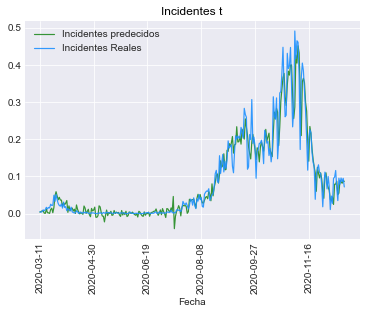

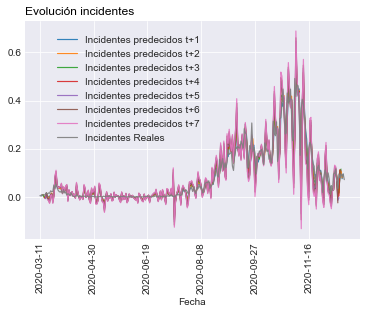

Gráficas para SVR Lag5


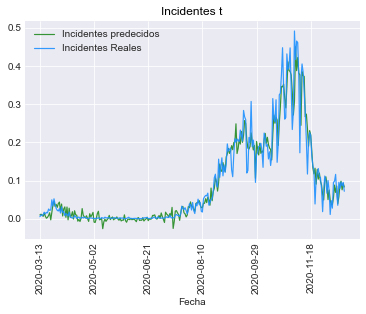

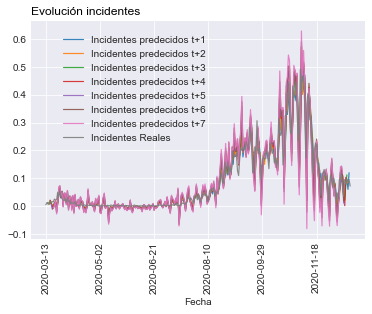

Gráficas para GBR Lag 3


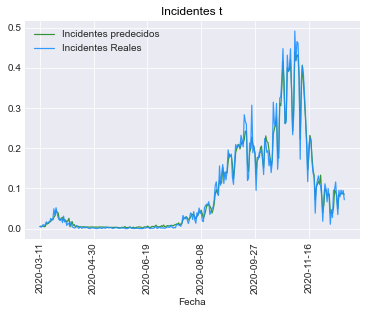

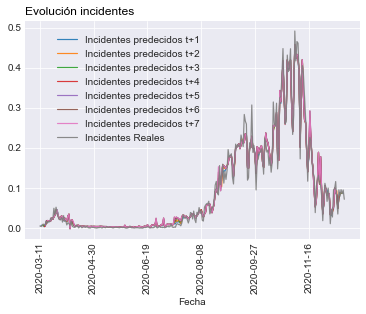

Gráficas para GBR Lag 5


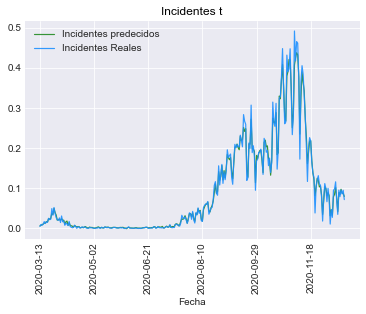

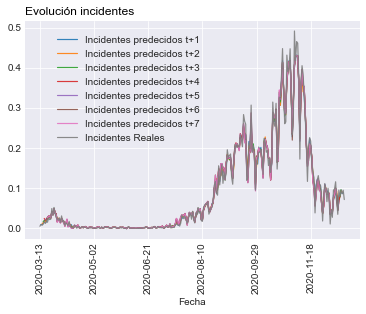

Gráficas para EN Lag3


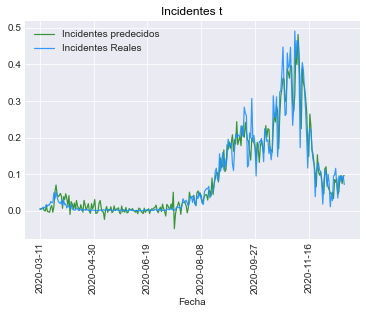

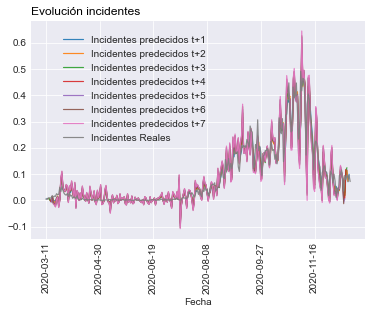

Gráficas para EN Lag5


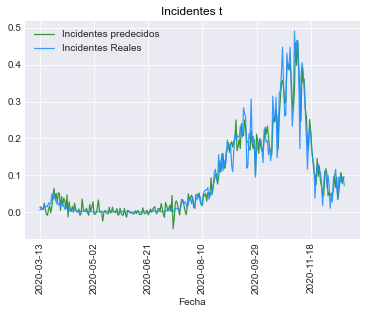

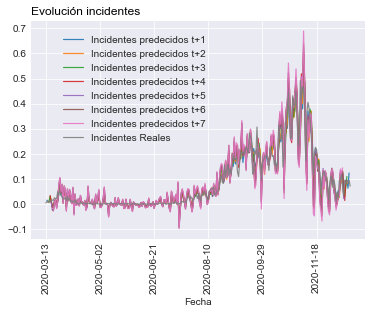

In [152]:
for i in range(0, len(modelos)):
    # Nombre del modelo
    nombre = nombres[i]
    # Si es numero par
    if i % 2 == 0:
        lag = 3
        X_train = X_train_3
        y_train = y_train_3
    else:
        lag = 5
        X_train = X_train_5
        y_train = y_train_5
        
    print('Gráficas para ' + str(nombre))
        
    # Realizamos la predicción sobre el conjunto de train
    y_pred = modelos[i].predict(X_train)
    # Visualizamos la prediccion
    grafica(y_pred, y_train, -1)
    
    # Calculamos el resto de pasos adelante
    if lag == 3:
        preds = calcular_predicciones_lag3(modelos[i], y_pred, X_train)
    if lag == 5:
        preds = calcular_predicciones_lag5(modelos[i], y_pred, X_train)
    
    # Generamos otra gráfica con las visualizaciones de las predicciones en los pasos adelante
    visualizar_predicciones(y_train, preds)